# Download and Install Textflow

In [29]:
!git clone https://github.com/sinai-uja/textflow.git
!(cd textflow; python -m pip install .)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
fatal: destination path 'textflow' already exists and is not an empty directory.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


ERROR: Directory '.' is not installable. Neither 'setup.py' nor 'pyproject.toml' found.


**Note:** In this point is important to restart the virtual enviroment. If you do not restart the enviroment probably get an AttributeError: module 'numpy.linalg._umath_linalg' has no attribute '_ilp64'

## Load the data

In this case, we are going to use the validation set from [OffendES: A New Corpus in Spanish for Offensive Language Research](https://aclanthology.org/2021.ranlp-1.123) (Plaza-del-Arco et al., RANLP 2021)



In [30]:
import os
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

pathValidationSet = './validation.csv'
dicLabel={0: 'OFP', 1: 'OFG', 2: 'NO', 3: 'NOM'}
df = pd.read_csv(pathValidationSet)
df['label']=[dicLabel[df['label'][i]] for i in df.index]

FileNotFoundError: [Errno 2] No such file or directory: './validation.csv'

In [ ]:
df

,comment_id,comment,influencer,influencer_gender,media,label
0,27341,Me encanta el videooo porciento aidii he subid...,dulceida,woman,youtube,NO
1,21310,"Ropa cara?veo dulceida shop, Zara.. y de todas...",lauraescane,woman,youtube,NO
2,23809,Y la perra seguia y seguia.jpg :v,windygirk,woman,youtube,OFP
3,14532,Malditas drogas,wismichu,man,youtube,NO
4,51651,"perdona el spam , es la primera vez que trato ...",dalas,man,instagram,NO
...,...,...,...,...,...,...
95,58740,Me alegra dalas . Soy nuevo seguidor y me aleg...,dalas,man,instagram,NO
96,6796,En resumen Dalas le callo la puta boca.,nauterplay,man,youtube,NOM
97,53415,"Genial!! Que te lleven a Alcaser, a ver las Ca...",soyunapringada,woman,instagram,NO
98,49449,Hola dalas quiero que sepáis que tienes mi tot...,dalas,man,instagram,NO


# Analyzing the data

In [ ]:
import nltk
import re
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer, WordPunctTokenizer
nltk.download('stopwords')
from nltk.stem import WordNetLemmatizer
nltk.download("wordnet")
nltk.download("omw-1.4")

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/mevr0003/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/mevr0003/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/mevr0003/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [ ]:
#Go to the textflow path
os.chdir('/home/mevr0003/proyectos/textflow')

In [ ]:
#Import the analyzers
from textflow.BDLASEAnalyzer import BDLASEAnalyzer
from textflow.ComplexityAnalyzer import ComplexityAnalyzer
from textflow.EmofinderAnalyzer import EmofinderAnalyzer
from textflow.EmojiAnalyzer import EmojiAnalyzer
from textflow.EmojiPolarityAnalyzer import EmojiPolarityAnalyzer
from textflow.EmoticonsPolarityAnalyzer import EmoticonsPolarityAnalyzer
from textflow.EmotionAnalyzer import EmotionAnalyzer
from textflow.IronyAnalyzer import IronyAnalyzer
from textflow.IsalAnalyzer import IsalAnalyzer
from textflow.LemmaAnalyzer import LemmaAnalyzer
from textflow.LexicalDiversityAnalyzer import LexicalDiversityAnalyzer
from textflow.LiwcAnalyzer import LiwcAnalyzer
from textflow.NcrAnalyzer import NcrAnalyzer
from textflow.NERAnalyzer import NERAnalyzer
from textflow.NGramsAnalyzer import NGramsAnalyzer
from textflow.PerplexityAnalyzer import PerplexityAnalyzer
from textflow.PolarityAnalyzer import PolarityAnalyzer
from textflow.POSAnalyzer import POSAnalyzer
from textflow.SelAnalyzer import SelAnalyzer
from textflow.StylometryAnalyzer import StylometryAnalyzer
from textflow.VolumetryAnalyzer import VolumetryAnalyzer

#Import the sequence string
from textflow.SequenceString import SequenceString

[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.9/12.9 MB 53.7 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


**Note:** It is important to download the resource that we are going to use in the analyzers.

In the lower code cell the analyzers are defined. These analyzers have many parameters that can be modified as desired. For more information, access the official [documentation](https://github.com/sinai-uja/textflow)

In [ ]:
#Create the analyzers with their parameters
bdlase = BDLASEAnalyzer()
complexity = ComplexityAnalyzer() #rutaArchivoCrea = creaPath, nlp = spacy.load("es_core_news_sm")
emofinder = EmofinderAnalyzer() #pathFile='emofinder_norm.csv', tokenizer = RegexpTokenizer("[\w']+")
emoji = EmojiAnalyzer() #language='es'
emojiPolarity = EmojiPolarityAnalyzer(positiveEmojiPath = "./textflow/emojis/emojiPositive.txt", negativeEmojiPath = './/textflow/emojis/emojiNegative.txt')
emoticonsPolarity = EmoticonsPolarityAnalyzer(positiveEmojiPath = ".//textflow/emoti-sp/emoticonsPositive.txt", negativeEmojiPath = './/textflow/emoti-sp/emoticonsNegative.txt')
emotion = EmotionAnalyzer()
ironity = IronyAnalyzer()
isal = IsalAnalyzer()
lemma = LemmaAnalyzer()
lexicalDiversity = LexicalDiversityAnalyzer(lemmatizer=WordNetLemmatizer().lemmatize)
liwc = LiwcAnalyzer()
ncr = NcrAnalyzer()
ner = NERAnalyzer()
n1 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 1)
n2 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 2,stopwords=[])
n3 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 3,stopwords=[])
n4 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 4,stopwords=[])
perplexity = PerplexityAnalyzer(device="cpu")
polarity = PolarityAnalyzer()
pos = POSAnalyzer()
sel = SelAnalyzer()
stylometry = StylometryAnalyzer(stopwords.words('spanish'),tokenizer = WordPunctTokenizer())
volumetry = VolumetryAnalyzer()

#Create our list of sequences. 
## In this case, we are going to use Sequence from String using our text column in the DataFrame
## Althought there are more types of Sequences and you can create your own Sequence. For more information about Sequence go to https://github.com/sinai-uja/textflow?tab=readme-ov-file#how-to-create-a-sequence
listSequence = []
for index, row in df.iterrows():
  s = SequenceString(row["comment"])
  listSequence.append(s)

Xformers is not installed correctly. If you want to use memory_efficient_attention to accelerate training use the following command to install Xformers
pip install xformers.


In [ ]:
#Analyze each sequence of our list of sequences. Each analyzer function receives:
  #  sequence: the Sequence we want to analyze.
  #  tag: the label to store the analysis result.
  #  levelOfAnalyzer: the path of the sequence level to analyze inside of the result.
  #  levelOfResult: [OPTIONAL] the path of the sequence level to store the result.

for s in listSequence:
  bdlase.analyze(s,"bdlase","text")
  complexity.analyze(s,"complexity","text")
  emofinder.analyze(s,"emofinder","text")
  emoji.analyze(s,"emoji","text")
  emojiPolarity.analyze(s,"emojiPolarity","text")
  emoticonsPolarity.analyze(s,"emoticons","text")
  emotion.analyze(s,"emotion","text")
  ironity.analyze(s,"ironity","text")
  isal.analyze(s,"isal","text")
  lemma.analyze(s,"lemmas","text")
  lexicalDiversity.analyze(s,"lexicalDiversity","text")
  liwc.analyze(s,"liwc","text")
  ncr.analyze(s,"ncr","text")
  ner.analyze(s,"NER","text")
  n1.analyze(s,"1-grams","text")
  n2.analyze(s,"2-grams","text")
  n3.analyze(s,"3-grams","text")
  n4.analyze(s,"4-grams","text")
  perplexity.analyze(s,"perplexity","text")
  polarity.analyze(s,"polarity","text")
  pos.analyze(s,"POS","text")
  sel.analyze(s,"sel","text")
  stylometry.analyze(s,"stylometry","text")
  volumetry.analyze(s,"volumetry","text")

  0%|          | 0/1 [00:00<?, ?it/s]


In [ ]:
# In order to know more about a sequence, I show you the Sequence structure
s

Sequence(
  format: string
  metadata: {'text': 'Por que crees que hablan mal de ti 1 haces mucha polemica 2 muestras mucho tu escote y ya nos cansamos 3 casi la mitad de tus subs son haters También pones títulos con doble sentido Y aún hay más', 'bdlase': [[[0.0, 0.0, 0.6666666666666666, 0.3333333333333333], [0.0, 0.0, 0.6666666666666666, 0.3333333333333333], [0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.6666666666666666, 0.3333333333333333]]], 'complexity': [{'nSentences': 2, 'nComplexSentence': 0, 'avglenSentence': 20.0, 'nPuntuationMarks': 0, 'nWords': 40, 'nRareWords': 11, 'nSyllabes': 61, 'nChar': 3, 'ILFW': 0.42857142857142855, 'LDI': 7.0, 'LC': 3.7142857142857144, 'SSR': 145.425, 'SCI': 10.0, 'ARI': 10.35325, 'huerta': 185.525, 'IFSZ': 91.82750000000001, 'polini': 51.097500000000004, 'mu': 99.20007956579805, 'minage': 7.7268574999999995, 'SOL': 6.489691271489054, 'crawford': 3.0404999999999998, 'min_depth': 1, 'max_depth': 8, 'mean_depth': 4.5}], 'emofinder': [[[0.0, 0.0, 0.0, 0.0], [0.0,

With the nexxt cells of code we are going to create a DataFrame with the results of the analyzers.

In [ ]:
# Calculate all of POS tags that are present in our sequences
## To do that, we go to the level where the results of the POS analyzer is saved 
## and create a set with all of the tags
POStags = set()
for seq in listSequence:
  for tag in seq.metadata['POS'][0]['FreqPOS']:
    POStags.add(tag)

In [ ]:
listSequence[0].metadata["POS"]

[{'srcPOS': ['PRON',
   'VERB',
   'DET',
   'PROPN',
   'PROPN',
   'ADJ',
   'AUX',
   'VERB',
   'DET',
   'NOUN',
   'ADP',
   'PROPN',
   'AUX',
   'VERB',
   'ADJ',
   'PRON',
   'AUX',
   'VERB',
   'VERB',
   'CCONJ',
   'DET',
   'VERB',
   'SCONJ',
   'PRON',
   'VERB',
   'NOUN',
   'PRON',
   'PROPN',
   'PROPN',
   'PROPN',
   'ADJ',
   'PROPN',
   'NOUN'],
  'srcPOSTag': [('me', 'PRON'),
   ('encanta', 'VERB'),
   ('el', 'DET'),
   ('videooo', 'PROPN'),
   ('porciento', 'PROPN'),
   ('aidii', 'ADJ'),
   ('he', 'AUX'),
   ('subido', 'VERB'),
   ('un', 'DET'),
   ('video', 'NOUN'),
   ('en', 'ADP'),
   ('@dulcealba.idolas', 'PROPN'),
   ('puedes', 'AUX'),
   ('verlo', 'VERB'),
   ('porfiii', 'ADJ'),
   ('me', 'PRON'),
   ('ha', 'AUX'),
   ('costado', 'VERB'),
   ('editarlo', 'VERB'),
   ('y', 'CCONJ'),
   ('tal', 'DET'),
   ('espero', 'VERB'),
   ('que', 'SCONJ'),
   ('te', 'PRON'),
   ('guste', 'VERB'),
   ('ojala', 'NOUN'),
   ('lo', 'PRON'),
   ('veas', 'PROPN'),
   ('te

In [ ]:
seq.metadata['polarity']

[[[{'label': 'NEG', 'score': 0.9986793398857117},
   {'label': 'NEU', 'score': 0.0008746858220547438},
   {'label': 'POS', 'score': 0.00044593747588805854}]]]

In [ ]:
#We need to define a list with all of the analyzer labels
labels = ["bdlase","complexity","emofinder","emoji","emojiPolarity","emoticons","emotion","ironity","isal","lemmas","lexicalDiversity","liwc","ncr","NER","1-grams","2-grams","3-grams","4-grams","perplexity","polarity","POS","sel","stylometry","volumetry"]

#Create a dictionary that will save all the information of the sequences
dicTotal = {}
for seq in listSequence:
  for l in seq.metadata:
    if l in labels:
      if l in ["polarity", "emotion", "ironity"]:
        for category in seq.metadata[l][0][0]:
          l_key = str(l+category['label'])
          dicTotal[l_key] = dicTotal.get(l_key, []) + [category['score']]
      elif l == 'POS':
        for cat in ['FreqPOS', 'RelFreqPOS']:
          for tag in POStags:
            dicTotal[cat+''+tag] = dicTotal.get(cat+''+tag, []) + [seq.metadata[l][0][cat].get(tag, 0)]
        l_key = str(l)+'POSTokens'
        dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0]['POSTokens']]
      elif l == 'perplexity':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      elif l == 'bdlase' or l == 'emofinder' or  l=='isal'or l == 'liwc' or l=='ncr' or l=='sel':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      else:
        for key in seq.metadata[l][0]:
          l_key = str(l+key)
          dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0][key]]

#Once we hace a dictTotal with all of the information of the sequences, we are going to create the DataFrame
for k in dicTotal:
  df[str(k)] = dicTotal[k]

#We show the columns of the dataFrame
print(df.columns.to_list())
#Save the DataFrame as csv File
df.to_csv('/home/mevr0003/proyectos/textflow/Examples/df_with_textflow_analysis.csv', index='False')

['comment_id', 'comment', 'influencer', 'influencer_gender', 'media', 'label', 'bdlase', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emofinder', 'emojiTextWithoutEmoji', 'emojiFreqEmoji', 'emojiNumEmojis', 'emojiPolaritynumEmojisPolarity', 'emojiPolaritypercentageEmojisPolarity', 'emojiPolaritydistinctEmojiFounded', 'emoticonsnumTextEmojisPolarity', 'emoticonspercentageTextEmojiPolarity', 'emoticonsdistinctTextEmojiFounded', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionf

# Results of Data Analysis

In [ ]:
#Import the Test and Visualization Modules of TextFlow
import os
import pandas as pd
from textflow.Test import Test
from textflow.Visualization import Visualization

In [ ]:
#Read the dataFrame with all the results of the analyzer for each sequence
df = pd.read_csv('/content/drive/MyDrive/Investigacion/TextFlow/df_with_textflow_analysis.csv') #df_with_textflow_analysis.csv

## Most Frequent Words, N-grams and POS words

### WordClouds


In [ ]:
#Create the visualization object
# It receives:
## savePath: an string with the path where different graphics where be saved. By default savePath= '.'
## n_cols: the number of columns of the subplot grid. By default n_cols=6
## cmap: a colormap that is apply to the images. By default cmap=sns.diverging_palette(230, 20, as_cmap=True)
v = Visualization()

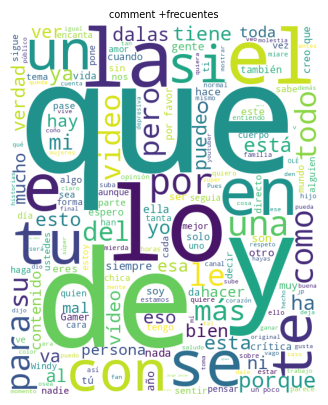

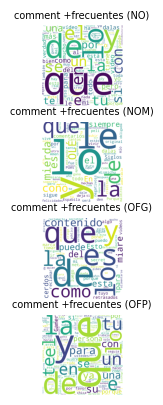

In [ ]:
#We use the wordCloud function to see the most frequent words
## All of the dataset (without groupby)
v.show_wordCloud(df,['comment'])
## For each label of the dataset (Grouping the DF by 'label column)
v.show_wordCloud(df,['comment'],groupby='label')

### N-Gramas

In [ ]:
#If we load the dataFrame from csv, some dict, list and other types of object are of string type, so qe need to use the eval function
df['1-gramsfreqN-Grams']=df['1-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['2-gramsfreqN-Grams']=df['2-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['3-gramsfreqN-Grams']=df['3-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['4-gramsfreqN-Grams']=df['4-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['POSPOSTokens']=df['POSPOSTokens'].apply(lambda x: eval(x))
df['label']=df['label'].apply(lambda x: dicLabel[x])

<Figure size 640x480 with 0 Axes>

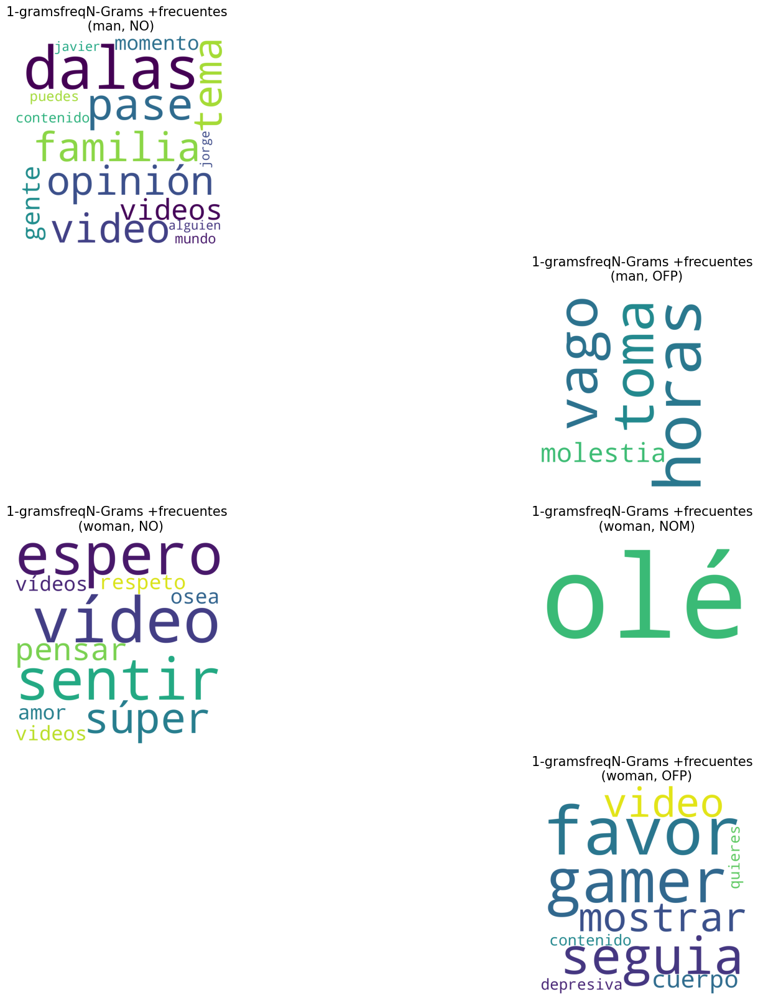

<Figure size 640x480 with 0 Axes>

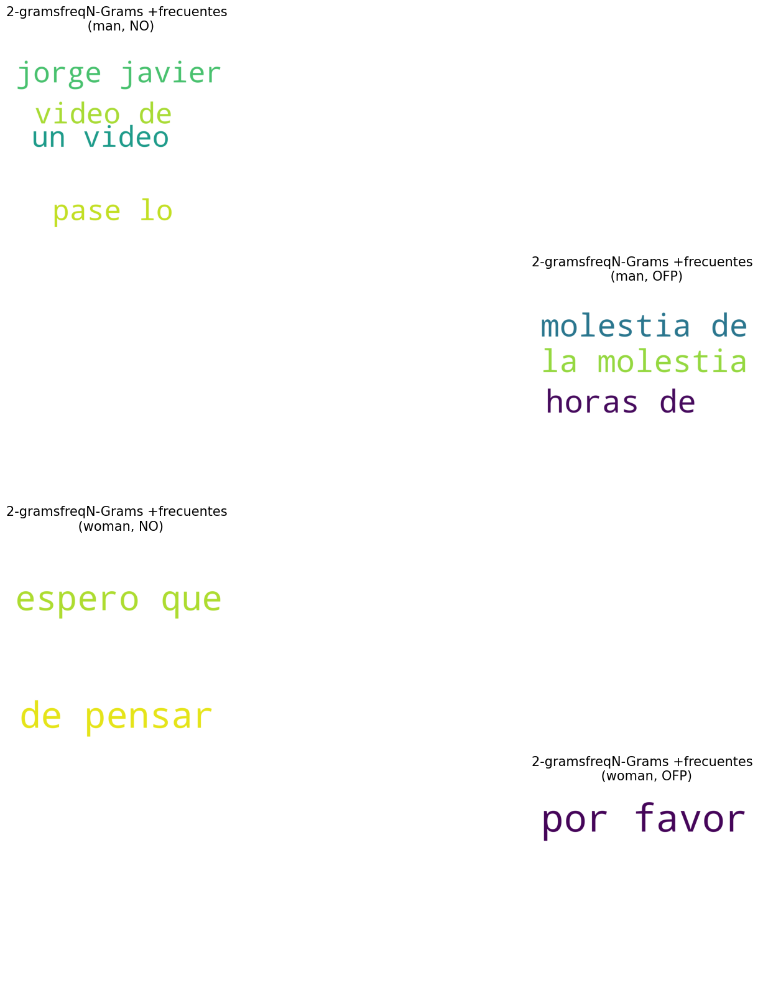

<Figure size 640x480 with 0 Axes>

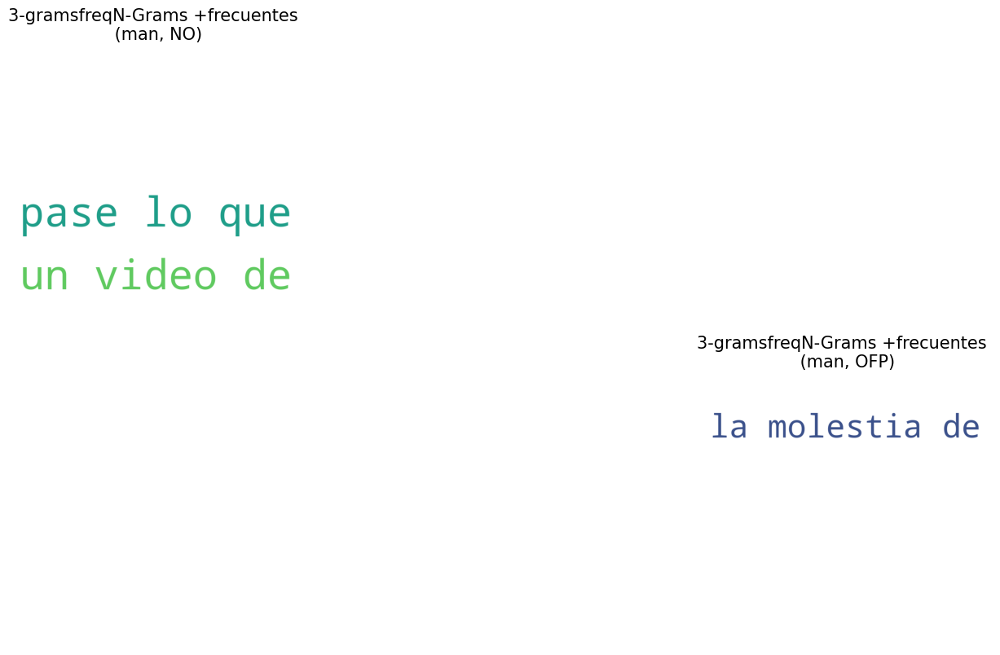

<Figure size 640x480 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

In [31]:

from spacy.lang.es.stop_words import STOP_WORDS
visualizer=Visualization('./textflow/Examples/')
new_df = pd.DataFrame()
for ngramas in [str(n+1)+"-gramsfreqN-Grams" for n in range(4)]:
    newdf = df.groupby(['influencer_gender', 'label'])[ngramas].agg(lambda x: dict(sorted({k: sum(d.get(k, 0) for d in x) for k in set().union(*x)}.items(), key=lambda item:item[1], reverse=True))).reset_index()
    ngramsArray=[]
    for i in newdf.index:
        ngramsDict= newdf[ngramas][i].copy()
        for k in newdf[ngramas][i]:
            valid = False
            for e in k.split(' '):
                if e not in STOP_WORDS and len(e) > 1:
                    valid = True
                    break
            if not valid or  ngramsDict[k] < 3:
                del ngramsDict[k]
        ngramsArray.append(ngramsDict)
    new_df[ngramas], new_df['Sexo'], new_df['label'] = ngramsArray, newdf['influencer_gender'], newdf['label']
visualizer.show_wordCloud(new_df,[str(n+1)+"-gramsfreqN-Grams" for n in range(4)], widthGraphic = 20,heightGraphic=20,hspace= 0.25,titleGraphicSize= 15,groupby=['Sexo','label'])

### POS

<Figure size 640x480 with 0 Axes>

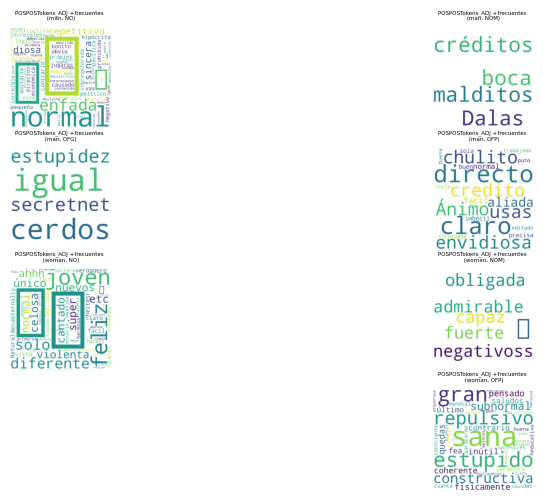

<Figure size 640x480 with 0 Axes>

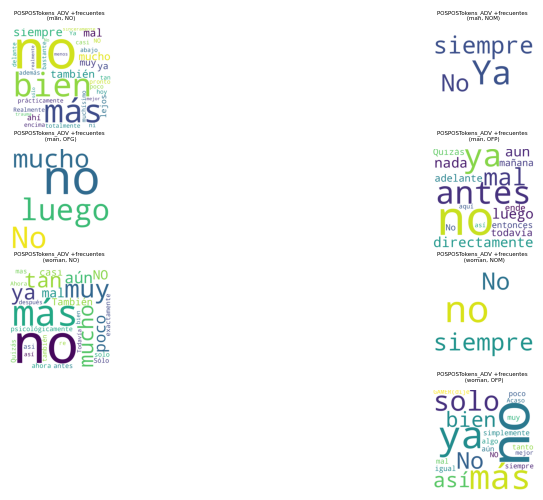

<Figure size 640x480 with 0 Axes>

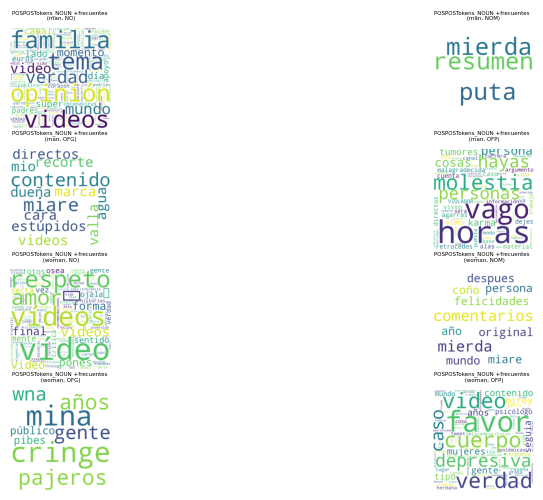

<Figure size 640x480 with 0 Axes>

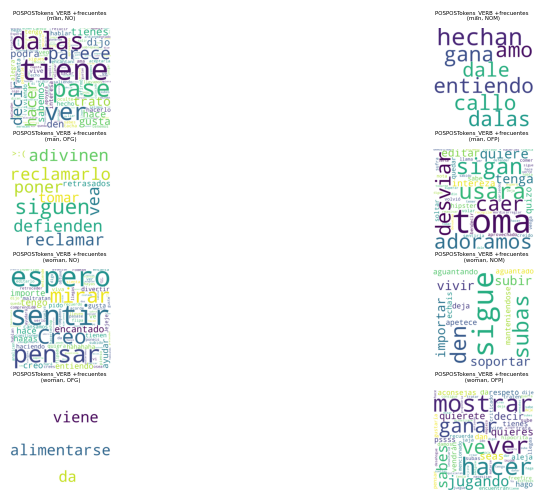

In [32]:
POS_LIST = ["ADJ", "ADV", "NOUN", "VERB"]
visualizer=Visualization('./textflow/Examples/')
new_df = pd.DataFrame()
first=True
for pos in POS_LIST:
    df['POSPOSTokens'+"_"+pos] = [df['POSPOSTokens'][i].get(pos, {}) for i in df.index]
    newdf = df.groupby(['influencer_gender', 'label'])['POSPOSTokens_'+pos].agg(lambda x: dict(sorted({k: sum(d.get(k, 0) for d in x) for k in set().union(*x)}.items(), key=lambda item:item[1], reverse=True))).reset_index()
    newdf = newdf.drop(['influencer_gender', 'label'], axis=1) if first==False else newdf
    first = False
    new_df = pd.concat([new_df, newdf], axis=1)
visualizer.show_wordCloud(new_df,['POSPOSTokens'+"_"+pos for pos in POS_LIST], hspace= 1.2,titleGraphicSize= 4,groupby=['influencer_gender','label'])

## Normality and significant Tests

### Tests with visualization graphics

---------------------------------------NORMALITY TEST---------------------------------------
Columnas 95
Pass the test of Shapiro
['complexitySSR', 'lexicalDiversityRootTTR', 'stylometryDugast']
Pass the test of D'Agostino
['complexityILFW', 'complexitySSR', 'lemmasavgLemmas', 'lexicalDiversityRootTTR', 'RelFreqPOSPRON', 'RelFreqPOSVERB', 'RelFreqPOSDET', 'stylometryDugast']
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 15.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 10.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 5.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 2.5 level of significance
Pass the test of Anderson-Darling
['comp

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,Hombre,Mujer,1042.0,0.153492,-0.726995,0.470760,0.484778,0.487914
1,FreqPOSINTJ,Hombre,Mujer,1327.0,0.159606,1.352963,0.182406,2.024463,0.157959
2,stylometryHerdan,Hombre,Mujer,1330.0,0.581200,0.973298,0.335285,0.802267,0.372611
3,complexityILFW,Hombre,Mujer,1126.0,0.395599,-0.607666,0.546273,0.349141,0.555960
4,emotionjoy,Hombre,Mujer,902.0,0.016728,-0.994299,0.325063,1.287263,0.259320
5,emotiondisgust,Hombre,Mujer,1015.0,0.106641,-1.305573,0.197921,1.511260,0.221890
6,emotionothers,Hombre,Mujer,1535.0,0.049399,1.561050,0.125082,3.254372,0.074305
7,lexicalDiversityHDD,Hombre,Mujer,1130.0,0.411404,-0.410032,0.683607,0.273889,0.601916
8,RelFreqPOSPRON,Hombre,Mujer,1473.0,0.122594,1.541642,0.129728,2.458981,0.120078
9,complexitynSentences,Hombre,Mujer,1137.0,0.402759,-0.724066,0.472540,0.544887,0.462178


{'Students t-test': {'Reject H0': ['emotionjoy', 'emotionothers', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['emotionsurprise', 'FreqPOSINTJ', 'stylometryHerdan', 'complexityILFW', 'emotiondisgust', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'complexitynSentences', 'stylometryMass', 'RelFreqPOSNUM', 'complexitynComplexSentence', 'comment_id', 'RelFreqPOSSYM', 'polarityNEG', 'RelFreqPOSVERB', 'volumetryavgWordsLen', 'RelFreqPOSSCONJ', 'lemmasavgLemmas', 'lexicalDiversityMTLDMAWrap', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'emotionfear', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'ironityNI', 'lexicalDiversityMSTTR', 'RelFreqPOSSPACE', 'RelFreqPOSADJ', 'complexitynChar', 'complexitymean_depth', 'RelFreqPOSINTJ', 'lexicalDiversityLogTTR', 'RelFreqPOSDET', 'RelFreqPOSADP', 'lexicalDiversityMATTR', 'RelFreqPOSPUNCT', 'emotionsadness', 'emotionanger', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'stylometryTTR', 'lexicalDiversityMaasTTR', 'com

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,Hombre,Mujer,1377.0,0.381198,498.0,0.259326,0.772883,0.379327
1,complexitynSentences,Hombre,Mujer,1137.0,0.402759,232.5,0.549671,0.706340,0.400662
2,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,110.0,0.347515,0.551709,0.457620
3,complexityavglenSentence,Hombre,Mujer,1368.0,0.415744,462.0,0.196236,0.667938,0.413771
4,complexitynPuntuationMarks,Hombre,Mujer,1372.5,0.392535,472.5,0.791935,0.737056,0.390606
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,Hombre,Mujer,1125.5,0.394419,465.0,0.144754,0.731160,0.392507
91,volumetrywords,Hombre,Mujer,1332.5,0.569346,504.0,0.388857,0.327714,0.567008
92,volumetryuniqueWords,Hombre,Mujer,1343.5,0.518923,486.0,0.408999,0.420495,0.516690
93,volumetrychars,Hombre,Mujer,1330.0,0.581196,509.5,0.420737,0.308121,0.578835


{'mannwhitneyu': {'Reject H0': ['complexitypolini', 'emotionothers', 'emotionjoy', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'l

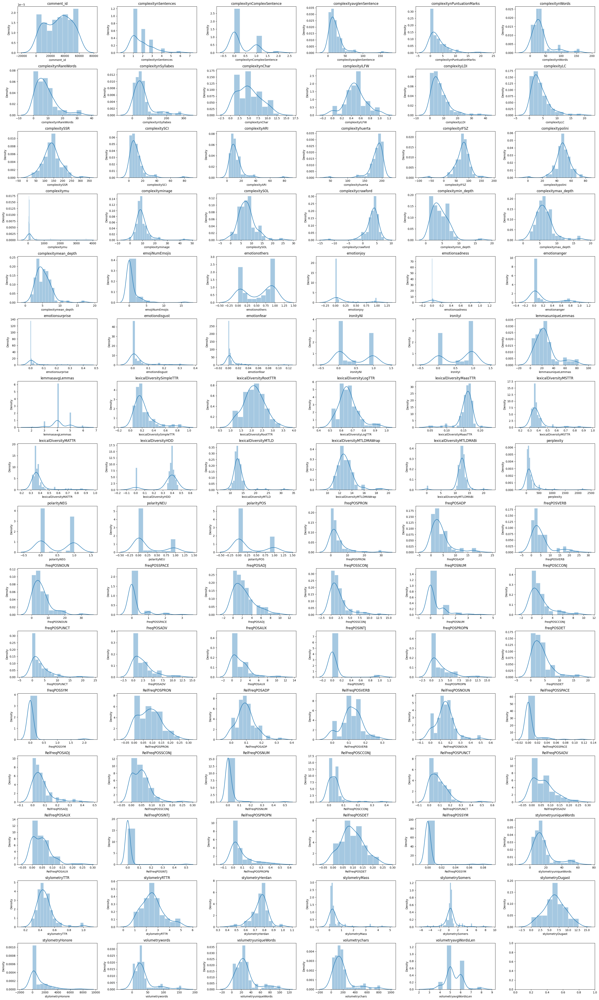

---------------------------------------PROBPLOT GRAPHICS---------------------------------------


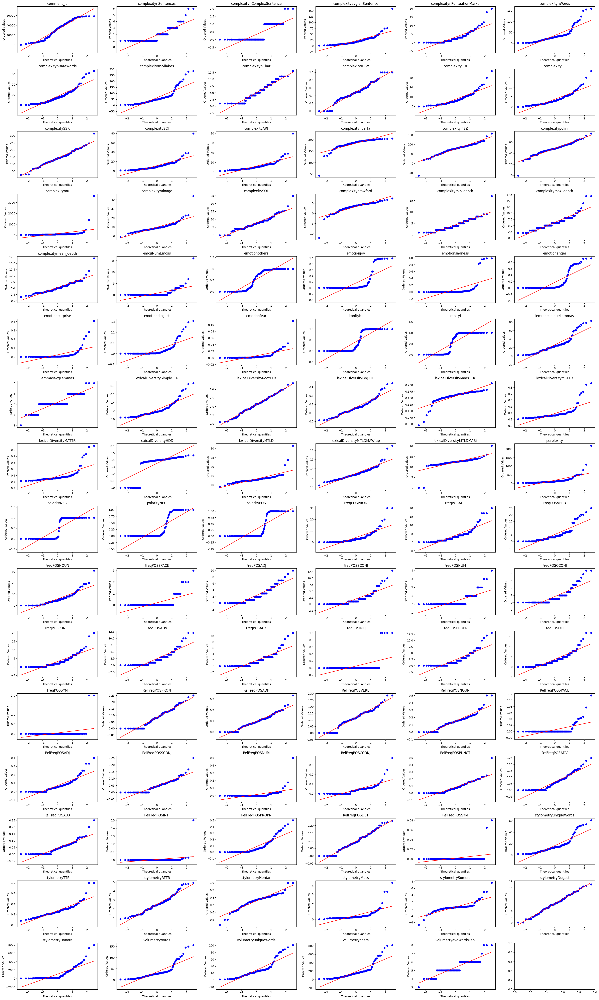

---------------------------------------KDE GRAPHICS---------------------------------------


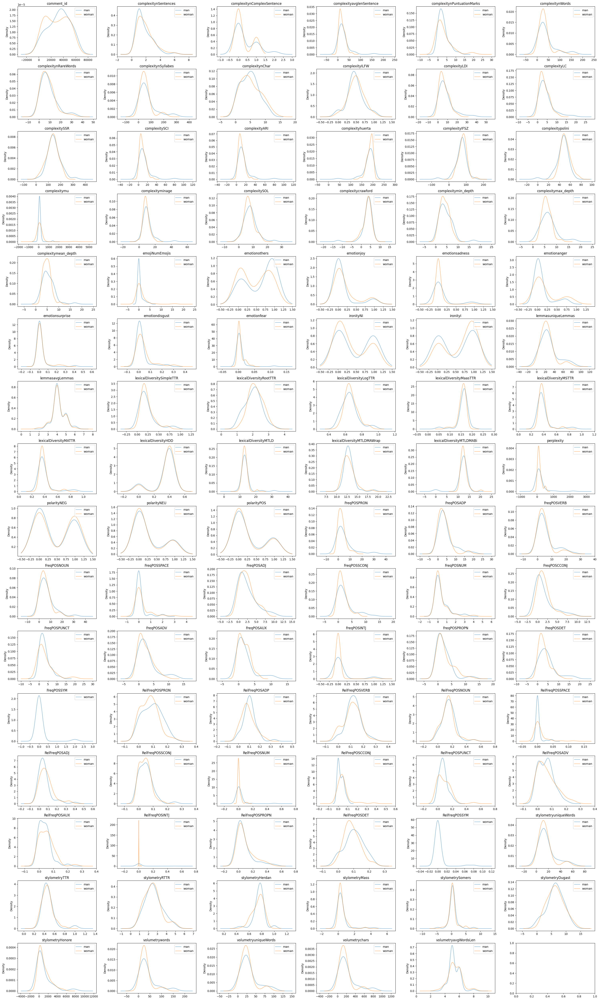

---------------------------------------BOXPLOT GRAPHICS---------------------------------------


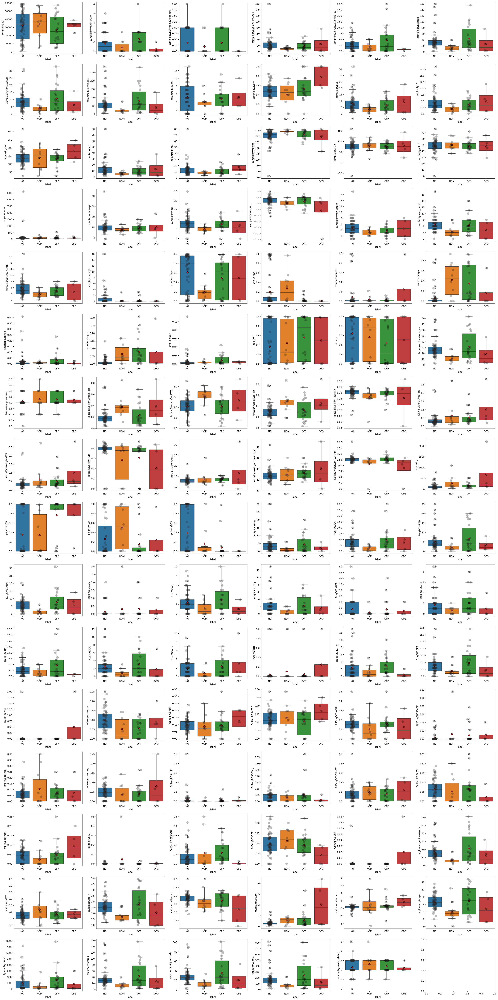

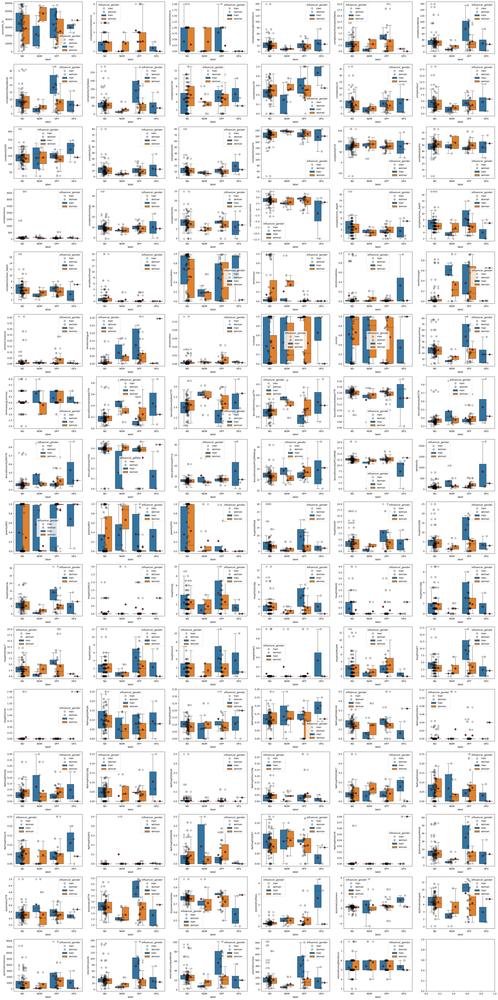

In [33]:
t=Test()
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
v=Visualization()
testResults=t.report(df[df['influencer_gender']=="man"],df[df['influencer_gender']=="woman"],"Hombre","Mujer",v,'influencer_gender',['label','label'],[None,'influencer_gender'])

In [34]:
testResults.keys()

dict_keys(['normalTest', 'parametricTest', 'nonParametricTest'])

In [35]:
testResults.keys()
print(testResults['normalTest'][0])
print(testResults['normalTest'][1])

                            Shapiro stat  Shapiro p-value  D'Agostino stat  \
comment_id                      0.943080     2.986405e-04        36.715430   
complexitynSentences            0.756587     1.403096e-11        36.226106   
complexitynComplexSentence      0.615949     8.734215e-15        23.645830   
complexityavglenSentence        0.692138     3.550446e-13       109.828632   
complexitynPuntuationMarks      0.776962     5.150198e-11        61.496269   
...                                  ...              ...              ...   
stylometryHonore                0.683087     2.214561e-13        63.723534   
volumetrywords                  0.753795     1.180914e-11        53.975317   
volumetryuniqueWords            0.828557     2.065794e-09        35.835871   
volumetrychars                  0.761839     1.947611e-11        52.300309   
volumetryavgWordsLen            0.820888     1.143945e-09        14.969375   

                            D'Agostino p-value  Anderson-Darlin

In [36]:
t=Test()
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
v=Visualization('/content')
testResults=t.report(df[df['influencer_gender']=="man"],df[df['influencer_gender']=="woman"],"Hombre","Mujer")

---------------------------------------NORMALITY TEST---------------------------------------
Columnas 95
Pass the test of Shapiro
['complexitySSR', 'lexicalDiversityRootTTR', 'stylometryDugast']
Pass the test of D'Agostino
['complexityILFW', 'complexitySSR', 'lemmasavgLemmas', 'lexicalDiversityRootTTR', 'RelFreqPOSPRON', 'RelFreqPOSVERB', 'RelFreqPOSDET', 'stylometryDugast']
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 15.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 10.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 5.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 2.5 level of significance
Pass the test of Anderson-Darling
['comp

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,Hombre,Mujer,1042.0,0.153492,-0.726995,0.470760,0.484778,0.487914
1,FreqPOSINTJ,Hombre,Mujer,1327.0,0.159606,1.352963,0.182406,2.024463,0.157959
2,stylometryHerdan,Hombre,Mujer,1330.0,0.581200,0.973298,0.335285,0.802267,0.372611
3,complexityILFW,Hombre,Mujer,1126.0,0.395599,-0.607666,0.546273,0.349141,0.555960
4,emotionjoy,Hombre,Mujer,902.0,0.016728,-0.994299,0.325063,1.287263,0.259320
5,emotiondisgust,Hombre,Mujer,1015.0,0.106641,-1.305573,0.197921,1.511260,0.221890
6,emotionothers,Hombre,Mujer,1535.0,0.049399,1.561050,0.125082,3.254372,0.074305
7,lexicalDiversityHDD,Hombre,Mujer,1130.0,0.411404,-0.410032,0.683607,0.273889,0.601916
8,RelFreqPOSPRON,Hombre,Mujer,1473.0,0.122594,1.541642,0.129728,2.458981,0.120078
9,complexitynSentences,Hombre,Mujer,1137.0,0.402759,-0.724066,0.472540,0.544887,0.462178


{'Students t-test': {'Reject H0': ['emotionjoy', 'emotionothers', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['emotionsurprise', 'FreqPOSINTJ', 'stylometryHerdan', 'complexityILFW', 'emotiondisgust', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'complexitynSentences', 'stylometryMass', 'RelFreqPOSNUM', 'complexitynComplexSentence', 'comment_id', 'RelFreqPOSSYM', 'polarityNEG', 'RelFreqPOSVERB', 'volumetryavgWordsLen', 'RelFreqPOSSCONJ', 'lemmasavgLemmas', 'lexicalDiversityMTLDMAWrap', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'emotionfear', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'ironityNI', 'lexicalDiversityMSTTR', 'RelFreqPOSSPACE', 'RelFreqPOSADJ', 'complexitynChar', 'complexitymean_depth', 'RelFreqPOSINTJ', 'lexicalDiversityLogTTR', 'RelFreqPOSDET', 'RelFreqPOSADP', 'lexicalDiversityMATTR', 'RelFreqPOSPUNCT', 'emotionsadness', 'emotionanger', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'stylometryTTR', 'lexicalDiversityMaasTTR', 'com

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,Hombre,Mujer,1377.0,0.381198,498.0,0.259326,0.772883,0.379327
1,complexitynSentences,Hombre,Mujer,1137.0,0.402759,232.5,0.549671,0.706340,0.400662
2,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,110.0,0.347515,0.551709,0.457620
3,complexityavglenSentence,Hombre,Mujer,1368.0,0.415744,462.0,0.196236,0.667938,0.413771
4,complexitynPuntuationMarks,Hombre,Mujer,1372.5,0.392535,472.5,0.791935,0.737056,0.390606
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,Hombre,Mujer,1125.5,0.394419,465.0,0.144754,0.731160,0.392507
91,volumetrywords,Hombre,Mujer,1332.5,0.569346,504.0,0.388857,0.327714,0.567008
92,volumetryuniqueWords,Hombre,Mujer,1343.5,0.518923,486.0,0.408999,0.420495,0.516690
93,volumetrychars,Hombre,Mujer,1330.0,0.581196,509.5,0.420737,0.308121,0.578835


{'mannwhitneyu': {'Reject H0': ['complexitypolini', 'emotionothers', 'emotionjoy', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'l

### Tests comparing each offensive label according to gender

Cuando queremos tener en cuenta dos valores distintos de etiquetas para un mismo género, la columna del genero no se ubica junto con las categorías a comparar, por lo que habría que juntar todas las tablas que se generan en cada iteración del bucle. Eso lo hace la siguiente parte

In [37]:
categories = {'influencer_gender': ['man','woman'],
              'label':['OFP', 'OFG', 'NO', 'NOM']}
t1=Test()

In [38]:
dfFinal_noparam=pd.DataFrame()
dfFinal_param=pd.DataFrame()
genderArrayParametric = []
genderArrayNonParametric = []
for gender in categories['influencer_gender']:
  for ci in range(len(categories['label'])):
    for cj in range(ci+1, len(categories['label'])):
      dist_i = df[   (df['influencer_gender'] == gender) &
                      (df['label'] == categories['label'][ci])
                ]
      dist_j = df[   (df['influencer_gender'] == gender) &
                      (df['label'] == categories['label'][cj])
                ]
      print(gender)
      print(categories['label'][ci])
      print(dist_i)
      print(categories['label'][cj])
      print(dist_j)
      print('############################')
      if len(dist_i) >= 1 and len(dist_j) >= 1:
        testResult1 = t1.report(dist_i,dist_j,categories['label'][ci],categories['label'][cj])
        tr1_noparam = testResult1['nonParametricTest'][0] # DataFrame resultante mannwhitney
        tr1_param = testResult1['parametricTest'][0] # Dataframe resultante paramétrico
        if len(genderArrayNonParametric) == 0:
          genderArrayNonParametric = [gender for i in range(len(tr1_noparam))]
        else:
          genderArrayNonParametric.extend([gender for i in range(len(tr1_noparam))])
        if len(genderArrayParametric) == 0:
          genderArrayParametric = [gender for i in range(len(tr1_param))]
        else:
          genderArrayParametric.extend([gender for i in range(len(tr1_param))])

        dfFinal_noparam = pd.concat([dfFinal_noparam, tr1_noparam],axis=0)
        dfFinal_param = pd.concat([dfFinal_param, tr1_param],axis=0)

dfFinal_noparam['influencer_gender'] = genderArrayNonParametric
dfFinal_noparam.reset_index(drop=True, inplace=True)

dfFinal_param['influencer_gender'] = genderArrayParametric
dfFinal_param.reset_index(drop=True, inplace=True)

man
OFP
    comment_id                                            comment  influencer  \
40       16986  La chica claro que toma videos que no son de e...  nauterplay   
42       34595  Esa vieja no le intereza arreglar las cosas, y...       dalas   
73        4713  Wismichu usara la cortina de la abuela como ca...    wismichu   
76       53468  Vergüenza sentiría de defender lo que has demo...       dalas   
82       57405                                 VIOLADOR DE MIERDA       dalas   

   influencer_gender      media label  \
40               man    youtube   OFP   
42               man    youtube   OFP   
73               man    youtube   OFP   
76               man  instagram   OFP   
82               man  instagram   OFP   

                                               bdlase  complexitynSentences  \
40  [[0.6666666666666666, 0.0, 0.5, 0.666666666666...                     3   
42  [[0.5, 0.5, 0.5, 0.75], [0.0, 0.0, 0.0, 0.0], ...                     3   
73  [[0.0, 0.5, 1.0, 

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitymu,OFP,OFG,8.0,1.000000,-0.959490,0.438561,0.749201,0.419987
1,emotionsurprise,OFP,OFG,11.0,0.392857,0.365400,0.749839,0.025257,0.878942
2,FreqPOSADP,OFP,OFG,11.0,0.365323,1.062041,0.399500,0.932741,0.371449
3,stylometryHerdan,OFP,OFG,14.0,0.071429,2.271533,0.151080,4.581835,0.076095
4,emotionjoy,OFP,OFG,5.0,0.571429,-0.814750,0.500803,0.481999,0.513488
...,...,...,...,...,...,...,...,...,...
86,complexitymin_depth,OFP,OFG,8.5,0.880072,-0.285714,0.801970,0.065391,0.806710
87,FreqPOSSCONJ,OFP,OFG,11.0,0.365323,1.100000,0.386040,1.094595,0.335761
88,complexitySOL,OFP,OFG,9.5,0.652783,0.693251,0.559838,0.502432,0.505029
89,complexitySSR,OFP,OFG,5.0,0.571429,-1.115681,0.380631,1.582591,0.255129


{'Students t-test': {'Reject H0': [], 'Fail to Reject H0': ['complexitymu', 'emotionsurprise', 'FreqPOSADP', 'stylometryHerdan', 'emotionjoy', 'emotiondisgust', 'complexityminage', 'FreqPOSNOUN', 'lexicalDiversityHDD', 'emojiNumEmojis', 'RelFreqPOSPRON', 'FreqPOSPROPN', 'lemmasuniqueLemmas', 'comment_id', 'FreqPOSPUNCT', 'volumetryavgWordsLen', 'complexityARI', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'complexitynWords', 'polarityPOS', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'complexitynSyllabes', 'FreqPOSSPACE', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'stylometryHonore', 'complexitypolini', 'emotionanger', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'emotionsadness', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'stylometrySomers', 'RelFreqPOSCCONJ', 'FreqPOSVERB', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'FreqPOSCCONJ', 'RelFreqPOSADV', 'volumetrychars', 'FreqPOSINTJ', 'complex

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721
1,complexitynSentences,OFP,OFG,13.0,0.117066,0.0,0.250000,2.971930,0.084721
2,complexitynComplexSentence,OFP,OFG,12.0,0.168493,0.0,0.157299,2.400000,0.121335
3,complexityavglenSentence,OFP,OFG,9.0,0.785714,3.0,1.000000,0.200000,0.654721
4,complexitynPuntuationMarks,OFP,OFG,12.0,0.218798,0.0,0.250000,1.913924,0.166528
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,OFG,9.0,0.785714,2.0,0.750000,0.200000,0.654721
91,volumetrywords,OFP,OFG,11.5,0.293826,1.0,0.500000,1.439357,0.230243
92,volumetryuniqueWords,OFP,OFG,11.5,0.293826,1.0,0.500000,1.439357,0.230243
93,volumetrychars,OFP,OFG,12.0,0.250000,1.0,0.500000,1.800000,0.179712


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexicalDiversityMT

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,OFP,NO,97.0,0.801796,-0.484311,0.653488,0.094822,7.597729e-01
1,FreqPOSINTJ,OFP,NO,85.0,0.630954,NaN,NaN,0.279770,5.998494e-01
2,stylometryHerdan,OFP,NO,135.0,0.075789,-0.847186,0.444605,0.148525,7.020430e-01
3,complexityILFW,OFP,NO,109.5,0.448073,1.632647,0.177880,2.774809,1.037718e-01
4,emotionjoy,OFP,NO,45.0,0.075789,-1.447703,0.221263,0.891512,3.508811e-01
5,emotiondisgust,OFP,NO,155.0,0.006944,2.186678,0.094040,39.870792,1.895906e-07
6,emotionothers,OFP,NO,61.0,0.265176,-1.647935,0.174711,1.054541,3.107909e-01
7,lexicalDiversityHDD,OFP,NO,51.5,0.130020,-0.050758,0.961952,3.579208,6.594899e-02
8,RelFreqPOSPRON,OFP,NO,76.5,0.604301,0.761357,0.488858,0.505185,4.814600e-01
9,complexitynSentences,OFP,NO,140.0,0.033697,2.390457,0.075130,8.898002,4.903626e-03


{'Students t-test': {'Reject H0': ['emotiondisgust', 'complexitynSentences', 'stylometryDugast', 'emotionanger', 'stylometrySomers'], 'Fail to Reject H0': ['emotionsurprise', 'FreqPOSINTJ', 'stylometryHerdan', 'complexityILFW', 'emotionjoy', 'emotionothers', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'stylometryMass', 'RelFreqPOSNUM', 'comment_id', 'complexitynComplexSentence', 'FreqPOSSYM', 'RelFreqPOSSYM', 'polarityNEG', 'RelFreqPOSVERB', 'volumetryavgWordsLen', 'RelFreqPOSSCONJ', 'lexicalDiversityMTLDMAWrap', 'lemmasavgLemmas', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'emotionfear', 'polarityPOS', 'lexicalDiversityMTLD', 'ironityI', 'ironityNI', 'lexicalDiversityMSTTR', 'RelFreqPOSADJ', 'RelFreqPOSSPACE', 'complexitynChar', 'complexitymean_depth', 'RelFreqPOSINTJ', 'lexicalDiversityLogTTR', 'RelFreqPOSADP', 'RelFreqPOSDET', 'lexicalDiversityMATTR', 'RelFreqPOSPUNCT', 'emotionsadness', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'stylometryTTR', 'RelFreqPOSCCONJ

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NO,86.0,0.892543,5.0,0.625000,0.025397,0.873382
1,complexitynSentences,OFP,NO,140.0,0.033697,0.0,0.065600,4.601571,0.031943
2,complexitynComplexSentence,OFP,NO,115.0,0.256972,0.0,0.157299,1.337980,0.247390
3,complexityavglenSentence,OFP,NO,81.0,0.734741,5.0,0.625000,0.128706,0.719778
4,complexitynPuntuationMarks,OFP,NO,133.5,0.083238,1.5,0.187500,3.070710,0.079715
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NO,110.0,0.437179,3.0,0.312500,0.635031,0.425516
91,volumetrywords,OFP,NO,129.5,0.119991,3.0,0.312500,2.479827,0.115315
92,volumetryuniqueWords,OFP,NO,130.5,0.110628,3.0,0.312500,2.609254,0.106242
93,volumetrychars,OFP,NO,129.0,0.125027,3.0,0.312500,2.414706,0.120201


{'mannwhitneyu': {'Reject H0': ['complexitynSentences', 'emotionanger', 'emotiondisgust', 'stylometrySomers', 'stylometryDugast'], 'Fail to Reject H0': ['comment_id', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionsurprise', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitymu,OFP,NOM,1.0,0.015873,-2.323811,0.080798,5.688886,0.044190
1,emotionsurprise,OFP,NOM,7.0,0.309524,-0.070402,0.947253,0.006846,0.936088
2,FreqPOSADP,OFP,NOM,23.0,0.033895,2.101350,0.103495,4.782288,0.060217
3,stylometryHerdan,OFP,NOM,16.0,0.547619,0.329627,0.758221,0.103989,0.755360
4,emotionjoy,OFP,NOM,1.0,0.015873,-1.103112,0.331880,1.220380,0.301401
...,...,...,...,...,...,...,...,...,...
85,complexitymin_depth,OFP,NOM,13.0,1.000000,0.000000,1.000000,0.000000,1.000000
86,FreqPOSSCONJ,OFP,NOM,21.5,0.057347,2.348881,0.078611,6.611570,0.033061
87,complexitySOL,OFP,NOM,22.0,0.044909,2.792245,0.049199,7.548845,0.025155
88,RelFreqPOSADV,OFP,NOM,13.5,0.914184,-0.597366,0.582435,0.330750,0.581028


{'Students t-test': {'Reject H0': ['complexitymu', 'FreqPOSADP', 'emotionjoy', 'FreqPOSNOUN', 'RelFreqPOSAUX', 'FreqPOSAUX', 'lexicalDiversityRootTTR', 'complexitynSentences', 'complexitySOL'], 'Fail to Reject H0': ['emotionsurprise', 'stylometryHerdan', 'emotiondisgust', 'complexityminage', 'lexicalDiversityHDD', 'emojiNumEmojis', 'RelFreqPOSPRON', 'FreqPOSPROPN', 'lemmasuniqueLemmas', 'comment_id', 'FreqPOSPUNCT', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'complexitynWords', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'complexitynSyllabes', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'emotionsadness', 'complexitypolini', 'lexicalDiversitySimpleTTR', 'emotionanger', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'stylometrySomers', 'RelFreqPOSCCONJ', 'FreqPOSVERB', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'FreqPOSCCONJ', 'volumetrychars', 'FreqPOSINTJ', 'complexityILFW

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NOM,17.0,0.420635,3.0,0.312500,0.883636,0.347208
1,complexitynSentences,OFP,NOM,22.5,0.023151,0.0,0.058782,5.714286,0.016827
2,complexitynComplexSentence,OFP,NOM,20.0,0.070701,0.0,0.102470,3.750000,0.052808
3,complexityavglenSentence,OFP,NOM,20.0,0.150794,3.0,0.312500,2.454545,0.117185
4,complexitynPuntuationMarks,OFP,NOM,21.5,0.066075,1.0,0.125000,3.787013,0.051652
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NOM,19.0,0.222222,2.0,0.187500,1.843636,0.174525
91,volumetrywords,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800
92,volumetryuniqueWords,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800
93,volumetrychars,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800


{'mannwhitneyu': {'Reject H0': ['complexitynSentences', 'complexitymu', 'complexitySOL', 'emotionjoy', 'lexicalDiversityRootTTR', 'perplexity', 'FreqPOSADP', 'FreqPOSNOUN', 'FreqPOSAUX', 'RelFreqPOSAUX'], 'Fail to Reject H0': ['comment_id', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexityminage', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMA

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,OFG,NO,49.0,0.823285,-0.711780,0.550427,0.081812,0.776452
1,FreqPOSINTJ,OFG,NO,69.0,0.097872,1.000000,0.422650,3.093645,0.086867
2,stylometryHerdan,OFG,NO,28.0,0.189299,-1.776272,0.217671,23.079766,0.000026
3,complexityILFW,OFG,NO,103.5,0.009619,1.782084,0.216681,15.182619,0.000395
4,emotionjoy,OFG,NO,37.0,0.402670,-1.699795,0.231271,0.522375,0.474375
5,emotiondisgust,OFG,NO,54.0,1.000000,-0.685941,0.563592,0.372351,0.545456
6,emotionothers,OFG,NO,57.0,0.901412,-1.021803,0.414349,0.024968,0.875305
7,lexicalDiversityHDD,OFG,NO,3.0,0.007765,-1.107115,0.383575,27.620000,0.000006
8,RelFreqPOSPRON,OFG,NO,51.5,0.915996,1.795244,0.214461,0.055151,0.815625
9,complexitynSentences,OFG,NO,43.0,0.541051,0.000000,1.000000,0.518444,0.476030


{'Students t-test': {'Reject H0': ['complexityILFW', 'lexicalDiversityHDD', 'stylometrySomers', 'lexicalDiversityMTLDMABi'], 'Fail to Reject H0': ['emotionsurprise', 'FreqPOSINTJ', 'stylometryHerdan', 'emotionjoy', 'emotiondisgust', 'emotionothers', 'RelFreqPOSPRON', 'complexitynSentences', 'RelFreqPOSNUM', 'comment_id', 'complexitynComplexSentence', 'FreqPOSSYM', 'RelFreqPOSSYM', 'polarityNEG', 'RelFreqPOSVERB', 'volumetryavgWordsLen', 'RelFreqPOSSCONJ', 'lemmasavgLemmas', 'lexicalDiversityMTLDMAWrap', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'emotionfear', 'complexitySSR', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'ironityNI', 'lexicalDiversityMSTTR', 'RelFreqPOSADJ', 'RelFreqPOSSPACE', 'complexitynChar', 'complexitymean_depth', 'RelFreqPOSINTJ', 'lexicalDiversityLogTTR', 'RelFreqPOSADP', 'RelFreqPOSDET', 'lexicalDiversityMATTR', 'RelFreqPOSPUNCT', 'emotionsadness', 'emotionanger', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'stylo

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NO,35.0,0.345990,3.0,1.000000,1.002778,0.316639
1,complexitynSentences,OFG,NO,43.0,0.541051,1.5,1.000000,0.410023,0.521958
2,complexitynComplexSentence,OFG,NO,34.5,0.225147,0.0,0.317311,1.549710,0.213178
3,complexityavglenSentence,OFG,NO,36.0,0.356064,3.0,1.000000,0.901094,0.342488
4,complexitynPuntuationMarks,OFG,NO,18.0,0.057149,1.0,0.654721,3.720891,0.053736
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NO,34.0,0.304023,2.0,0.750000,1.111336,0.291792
91,volumetrywords,OFG,NO,34.0,0.303729,3.0,1.000000,1.112688,0.291498
92,volumetryuniqueWords,OFG,NO,34.0,0.303484,3.0,1.000000,1.113817,0.291254
93,volumetrychars,OFG,NO,33.5,0.291767,1.0,0.654721,1.167716,0.279871


{'mannwhitneyu': {'Reject H0': ['complexityILFW', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi', 'stylometrySomers'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitymu,OFG,NOM,4.0,0.392857,-10.971947,0.008205,1.025162,0.350373
1,emotionsurprise,OFG,NOM,4.0,0.392857,-0.176321,0.876280,0.111581,0.749717
2,stylometryHerdan,OFG,NOM,4.0,0.392857,-1.352440,0.308854,2.475756,0.166677
3,emotiondisgust,OFG,NOM,2.0,0.142857,-1.218294,0.347323,2.623805,0.156399
4,complexityminage,OFG,NOM,9.0,0.785714,0.182239,0.872194,0.212000,0.661419
...,...,...,...,...,...,...,...,...,...
69,FreqPOSPRON,OFG,NOM,10.0,0.522410,1.386750,0.299860,1.416201,0.278977
70,complexitymin_depth,OFG,NOM,5.5,0.648807,0.179605,0.874012,0.077860,0.789587
71,FreqPOSSCONJ,OFG,NOM,11.0,0.305507,1.511858,0.269703,1.674419,0.243241
72,complexitySOL,OFG,NOM,7.0,1.000000,0.474122,0.682133,0.284397,0.613000


{'Students t-test': {'Reject H0': [], 'Fail to Reject H0': ['complexitymu', 'emotionsurprise', 'stylometryHerdan', 'emotiondisgust', 'complexityminage', 'emotionjoy', 'lexicalDiversityHDD', 'emojiNumEmojis', 'RelFreqPOSPRON', 'FreqPOSPROPN', 'comment_id', 'FreqPOSPUNCT', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'FreqPOSSPACE', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'complexitypolini', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'emotionanger', 'emotionsadness', 'stylometryRTTR', 'stylometryTTR', 'stylometrySomers', 'RelFreqPOSCCONJ', 'FreqPOSVERB', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'RelFreqPOSADV', 'FreqPOSINTJ', 'complexityILFW', 'emotionothers', 'complexitynPuntuationMarks', 'stylometryMass', 'complexitynSentences', 'RelFreqPOSNUM', 'complexitynComplexSentence', 'FreqPOSSYM', 'RelFreqP

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NOM,11.0,0.392857,1.0,0.500000,1.088889,0.296718
1,complexitynSentences,OFG,NOM,10.0,0.301700,0.0,0.317311,1.666667,0.196706
2,complexitynComplexSentence,OFG,NOM,7.5,1.000000,NaN,NaN,NaN,NaN
3,complexityavglenSentence,OFG,NOM,6.0,0.785714,3.0,1.000000,0.200000,0.654721
4,complexitynPuntuationMarks,OFG,NOM,10.5,0.414216,2.0,0.750000,0.960000,0.327187
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NOM,7.5,1.000000,2.0,0.750000,0.000000,1.000000
91,volumetrywords,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497
92,volumetryuniqueWords,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497
93,volumetrychars,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexicalDiversityMT

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,NO,NOM,43.0,0.062610,0.645333,0.553863,0.081179,7.772135e-01
1,FreqPOSINTJ,NO,NOM,77.0,0.269690,-1.000000,0.373901,1.328563,2.560773e-01
2,stylometryHerdan,NO,NOM,132.5,0.094250,2.589903,0.060690,0.170408,6.820104e-01
3,complexityILFW,NO,NOM,119.0,0.254893,0.969468,0.387210,3.111304,8.558345e-02
4,emotionjoy,NO,NOM,62.0,0.282734,-1.004734,0.371873,0.214170,6.460907e-01
5,emotiondisgust,NO,NOM,31.0,0.016210,-1.858238,0.136679,27.152636,6.426336e-06
6,emotionothers,NO,NOM,142.0,0.037326,7.233516,0.001938,8.198107,6.715115e-03
7,lexicalDiversityHDD,NO,NOM,141.5,0.042075,1.566897,0.192204,24.637796,1.404568e-05
8,RelFreqPOSPRON,NO,NOM,129.5,0.119619,0.134655,0.899389,2.891194,9.702762e-02
9,complexitynSentences,NO,NOM,132.5,0.058693,1.000000,0.373901,3.056200,8.829864e-02


{'Students t-test': {'Reject H0': ['emotiondisgust', 'emotionothers', 'lexicalDiversityHDD', 'stylometryMass', 'lemmasavgLemmas', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'stylometryDugast', 'complexitymean_depth', 'lexicalDiversityLogTTR', 'emotionanger', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'stylometryTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMTLDMABi', 'complexitycrawford'], 'Fail to Reject H0': ['emotionsurprise', 'FreqPOSINTJ', 'stylometryHerdan', 'complexityILFW', 'emotionjoy', 'RelFreqPOSPRON', 'complexitynSentences', 'RelFreqPOSNUM', 'comment_id', 'complexitynComplexSentence', 'FreqPOSSYM', 'RelFreqPOSSYM', 'polarityNEG', 'RelFreqPOSVERB', 'volumetryavgWordsLen', 'RelFreqPOSSCONJ', 'lexicalDiversityMTLDMAWrap', 'emotionfear', 'complexitySSR', 'polarityPOS', 'lexicalDiversityMTLD', 'ironityI', 'ironityNI', 'lexicalDiversityMSTTR', 'RelFreqPOSADJ', 'RelFreqPOSSPACE', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'RelFreqPOSDET', 'lex

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,NO,NOM,128.0,0.138695,6.0,0.812500,2.292063,0.130037
1,complexitynSentences,NO,NOM,132.5,0.058693,0.0,0.317311,3.659538,0.055749
2,complexitynComplexSentence,NO,NOM,122.5,0.117256,0.0,0.157299,2.530864,0.111639
3,complexityavglenSentence,NO,NOM,162.5,0.004102,1.0,0.144127,8.352713,0.003851
4,complexitynPuntuationMarks,NO,NOM,156.5,0.007644,0.0,0.065600,7.223308,0.007196
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,NO,NOM,152.5,0.013494,0.0,0.067889,6.202018,0.012760
91,volumetrywords,NO,NOM,174.5,0.000812,0.0,0.067889,11.348558,0.000755
92,volumetryuniqueWords,NO,NOM,174.5,0.000807,0.0,0.067889,11.358465,0.000751
93,volumetrychars,NO,NOM,173.0,0.001012,0.0,0.062500,10.936826,0.000943


{'mannwhitneyu': {'Reject H0': ['complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexityLDI', 'complexityLC', 'complexitySCI', 'complexityhuerta', 'complexitymu', 'complexitySOL', 'complexitycrawford', 'complexitymax_depth', 'complexitymean_depth', 'emotionothers', 'emotionanger', 'emotiondisgust', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi', 'perplexity', 'FreqPOSPRON', 'FreqPOSADP', 'FreqPOSVERB', 'FreqPOSNOUN', 'FreqPOSSCONJ', 'FreqPOSPUNCT', 'FreqPOSADV', 'FreqPOSAUX', 'FreqPOSDET', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'stylometryuniqueWords', 'stylometryTTR', 'stylometryRTTR', 'stylometryMass', 'stylometryDugast', 'stylometryHonore', 'volumetrywords', 'volumetryuniqueWords', 'volumetrychars'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences'

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,OFP,OFG,10.0,0.888889,NaN,NaN,0.259355,0.617515
1,stylometryHerdan,OFP,OFG,4.0,0.555556,NaN,NaN,0.601797,0.449208
2,emotionjoy,OFP,OFG,11.0,0.777778,NaN,NaN,0.201219,0.659754
3,complexityminage,OFP,OFG,8.0,1.000000,NaN,NaN,0.003569,0.953099
4,FreqPOSNOUN,OFP,OFG,4.0,0.437142,NaN,NaN,0.187628,0.670681
...,...,...,...,...,...,...,...,...,...
83,complexitycrawford,OFP,OFG,11.0,0.777778,NaN,NaN,0.010775,0.918618
84,complexitymin_depth,OFP,OFG,0.5,0.141751,NaN,NaN,3.766967,0.070102
85,complexitySOL,OFP,OFG,7.5,0.922826,NaN,NaN,0.000098,0.992227
86,complexitySSR,OFP,OFG,8.0,1.000000,NaN,NaN,0.118462,0.735191


{'Students t-test': {'Reject H0': ['RelFreqPOSSYM'], 'Fail to Reject H0': ['emotionsurprise', 'stylometryHerdan', 'emotionjoy', 'complexityminage', 'FreqPOSNOUN', 'emotiondisgust', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'FreqPOSPROPN', 'lemmasuniqueLemmas', 'comment_id', 'volumetryavgWordsLen', 'complexityARI', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'complexitynWords', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'complexitynSyllabes', 'RelFreqPOSADJ', 'FreqPOSSPACE', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'stylometryHonore', 'complexitypolini', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'emotionsadness', 'emotionanger', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'RelFreqPOSCCONJ', 'stylometrySomers', 'FreqPOSVERB', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'FreqPOSCCONJ', 'RelFreqPOSADV', 'volumetrychars', 'FreqPOSINTJ', 'complexityILFW', 'emotionothers'

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,OFG,6.0,0.777778,0.0,1.0,0.232198,0.629899
1,complexitynSentences,OFP,OFG,13.5,0.355809,0.0,1.0,1.052632,0.304902
2,complexitynComplexSentence,OFP,OFG,10.5,0.688500,NaN,NaN,0.285714,0.592980
3,complexityavglenSentence,OFP,OFG,5.0,0.562898,0.0,1.0,0.455579,0.499698
4,complexitynPuntuationMarks,OFP,OFG,14.0,0.319452,0.0,1.0,1.199339,0.273454
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,OFG,15.0,0.333333,0.0,1.0,1.569659,0.210256
91,volumetrywords,OFP,OFG,8.0,1.000000,0.0,1.0,0.009307,0.923145
92,volumetryuniqueWords,OFP,OFG,10.0,0.846922,0.0,1.0,0.083851,0.772145
93,volumetrychars,OFP,OFG,10.0,0.847079,0.0,1.0,0.083678,0.772374


{'mannwhitneyu': {'Reject H0': ['FreqPOSSYM', 'RelFreqPOSSYM'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDivers

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,OFP,NO,243.0,0.916101,-0.073721,0.942146,0.357776,0.552882
1,stylometryHerdan,OFP,NO,203.0,0.419257,-0.889935,0.386686,1.463655,0.232959
2,emotionjoy,OFP,NO,134.0,0.015394,-2.624961,0.018384,6.213019,0.016612
3,complexityminage,OFP,NO,231.0,0.879055,-0.397744,0.696076,0.011777,0.914088
4,emotiondisgust,OFP,NO,365.0,0.003062,2.161083,0.046195,9.144056,0.004197
...,...,...,...,...,...,...,...,...,...
64,complexitycrawford,OFP,NO,244.0,0.897550,-0.222908,0.826428,0.050195,0.823785
65,complexitymin_depth,OFP,NO,195.0,0.312878,-0.865914,0.399336,1.121889,0.295426
66,complexitySOL,OFP,NO,224.5,0.760098,-0.810424,0.429587,0.209679,0.649325
67,complexitySSR,OFP,NO,222.0,0.716700,-0.515646,0.613153,0.264072,0.609967


{'Students t-test': {'Reject H0': ['emotionjoy', 'emotiondisgust', 'RelFreqPOSPRON', 'polarityPOS', 'lexicalDiversityMTLD', 'emotionanger', 'polarityNEG', 'lexicalDiversityMTLDMAWrap'], 'Fail to Reject H0': ['emotionsurprise', 'stylometryHerdan', 'complexityminage', 'lexicalDiversityHDD', 'comment_id', 'volumetryavgWordsLen', 'complexityARI', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'RelFreqPOSADJ', 'FreqPOSSPACE', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'complexitypolini', 'emotionsadness', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'stylometryTTR', 'RelFreqPOSCCONJ', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'RelFreqPOSADV', 'FreqPOSINTJ', 'complexityILFW', 'emotionothers', 'complexitynSentences', 'stylometryMass', 'RelFreqPOSNUM', 'complexitynComplexSentence', 'FreqPOSADV', 'RelFreqPOSSYM', 'RelFreqPOSVERB', 'RelFreqPOSSCONJ', 'lemmasavgLe

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NO,206.0,0.460863,65.0,0.611221,0.561198,0.453778
1,complexitynSentences,OFP,NO,253.0,0.717436,41.5,0.773972,0.140150,0.708132
2,complexitynComplexSentence,OFP,NO,226.0,0.725287,1.5,1.000000,0.134454,0.713858
3,complexityavglenSentence,OFP,NO,207.0,0.475043,64.0,0.579056,0.527088,0.467834
4,complexitynPuntuationMarks,OFP,NO,239.0,0.990451,28.0,0.387272,0.000573,0.980904
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NO,309.5,0.096464,63.0,0.547668,2.802114,0.094140
91,volumetrywords,OFP,NO,204.0,0.432728,74.0,0.926514,0.634000,0.425892
92,volumetryuniqueWords,OFP,NO,203.5,0.425770,67.0,0.958726,0.653128,0.418996
93,volumetrychars,OFP,NO,217.5,0.639592,73.5,0.926514,0.230377,0.631245


{'mannwhitneyu': {'Reject H0': ['emotionjoy', 'emotionanger', 'emotiondisgust', 'lexicalDiversityMTLD', 'lexicalDiversityMTLDMAWrap', 'perplexity', 'polarityNEG', 'polarityPOS', 'RelFreqPOSPRON'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionsurprise', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'l

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,OFP,NOM,36.0,0.648591,2.095824,0.104143,0.938769,0.344167
1,stylometryHerdan,OFP,NOM,49.5,0.610477,-0.281964,0.791958,0.102587,0.752069
2,emotionjoy,OFP,NOM,11.0,0.011392,-3.632099,0.022119,33.618011,0.000011
3,complexityminage,OFP,NOM,57.0,0.282676,0.470912,0.662237,1.285669,0.270257
4,emotiondisgust,OFP,NOM,45.0,0.879547,-0.295297,0.782461,0.071457,0.791964
...,...,...,...,...,...,...,...,...,...
72,complexitycrawford,OFP,NOM,49.0,0.648591,-1.081246,0.340421,0.074001,0.788386
73,complexitymin_depth,OFP,NOM,50.0,0.575757,0.688247,0.529133,0.392919,0.537859
74,complexitySOL,OFP,NOM,60.5,0.166599,0.147436,0.889921,1.654220,0.213077
75,complexitySSR,OFP,NOM,39.0,0.820081,-1.382597,0.238966,0.325744,0.574533


{'Students t-test': {'Reject H0': ['emotionjoy', 'comment_id', 'polarityPOS', 'lexicalDiversityMTLD', 'polarityNEU', 'polarityNEG'], 'Fail to Reject H0': ['emotionsurprise', 'stylometryHerdan', 'complexityminage', 'emotiondisgust', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'volumetryavgWordsLen', 'complexityARI', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'stylometryHonore', 'complexitypolini', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'emotionsadness', 'emotionanger', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'RelFreqPOSCCONJ', 'stylometrySomers', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'FreqPOSCCONJ', 'RelFreqPOSADV', 'FreqPOSINTJ', 'complexityILFW', 'emotionothers', 'complexitynSentences', 'stylometryMass', 'complexityLC', 'RelFreqPOSNUM', 'complexitynComplexSentence', 'FreqPOSADV', 'FreqPOSSYM', 'RelFreqPOSS

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NOM,13.0,0.019291,2.0,0.187500,5.341688,0.020821
1,complexitynSentences,OFP,NOM,45.0,0.868034,3.0,1.000000,0.043137,0.835467
2,complexitynComplexSentence,OFP,NOM,35.5,0.509581,0.0,0.157299,0.504412,0.477568
3,complexityavglenSentence,OFP,NOM,52.0,0.480615,6.0,0.812500,0.554277,0.456575
4,complexitynPuntuationMarks,OFP,NOM,34.5,0.550665,5.0,0.625000,0.405194,0.524419
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NOM,56.0,0.319283,6.0,0.812500,1.118670,0.290205
91,volumetrywords,OFP,NOM,54.0,0.388257,6.0,0.812500,0.813602,0.367057
92,volumetryuniqueWords,OFP,NOM,51.5,0.504967,6.5,1.000000,0.498312,0.480243
93,volumetrychars,OFP,NOM,53.0,0.433227,6.0,0.812500,0.677109,0.410584


{'mannwhitneyu': {'Reject H0': ['comment_id', 'emotionjoy', 'lexicalDiversityMTLD', 'polarityNEG', 'polarityNEU', 'polarityPOS'], 'Fail to Reject H0': ['complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR',

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,OFG,NO,9.0,0.689655,NaN,NaN,0.114784,0.737383
1,FreqPOSADP,OFG,NO,20.5,0.464008,NaN,NaN,0.197713,0.660118
2,stylometryHerdan,OFG,NO,22.0,0.482759,NaN,NaN,0.519637,0.477192
3,emotionjoy,OFG,NO,4.0,0.344828,NaN,NaN,0.444207,0.510754
4,complexityminage,OFG,NO,15.0,0.965517,NaN,NaN,0.007641,0.930987
...,...,...,...,...,...,...,...,...,...
73,complexitymin_depth,OFG,NO,25.0,0.203537,NaN,NaN,1.417782,0.244132
74,FreqPOSSCONJ,OFG,NO,2.5,0.174434,NaN,NaN,1.262233,0.271119
75,complexitySOL,OFG,NO,15.0,0.952204,NaN,NaN,0.020609,0.886916
76,complexitySSR,OFG,NO,15.0,0.952340,NaN,NaN,0.023409,0.879535


{'Students t-test': {'Reject H0': ['FreqPOSSPACE', 'RelFreqPOSSYM', 'RelFreqPOSSPACE'], 'Fail to Reject H0': ['emotionsurprise', 'FreqPOSADP', 'stylometryHerdan', 'emotionjoy', 'complexityminage', 'FreqPOSNOUN', 'emotiondisgust', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'lemmasuniqueLemmas', 'comment_id', 'FreqPOSPUNCT', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'complexityARI', 'RelFreqPOSAUX', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'complexitypolini', 'emotionsadness', 'lexicalDiversityRootTTR', 'emotionanger', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'RelFreqPOSCCONJ', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'RelFreqPOSADV', 'FreqPOSINTJ', 'complexityILFW', 'emotionothers', 'complexitynPuntuationMarks', 'complexitynSentences', 'stylometryMass', 'complexityLC', 'RelFreqP

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NO,19.0,0.689655,0.0,1.0,0.357143,0.550097
1,complexitynSentences,OFG,NO,6.5,0.366157,NaN,NaN,0.937500,0.332922
2,complexitynComplexSentence,OFG,NO,10.0,0.589154,0.0,1.0,0.380952,0.537094
3,complexityavglenSentence,OFG,NO,19.5,0.549802,0.0,1.0,0.432782,0.510627
4,complexitynPuntuationMarks,OFG,NO,4.5,0.270551,NaN,NaN,1.352584,0.244827
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NO,10.0,0.675668,0.0,1.0,0.228628,0.632543
91,volumetrywords,OFG,NO,9.0,0.590358,0.0,1.0,0.357760,0.549753
92,volumetryuniqueWords,OFG,NO,8.5,0.549753,0.0,1.0,0.432889,0.510575
93,volumetrychars,OFG,NO,9.0,0.590587,0.0,1.0,0.357319,0.549999


{'mannwhitneyu': {'Reject H0': ['FreqPOSSPACE', 'FreqPOSSYM', 'RelFreqPOSSPACE', 'RelFreqPOSSYM'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'l

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitymu,OFG,NOM,3.0,1.000000,NaN,NaN,0.230622,0.656145
1,emotionsurprise,OFG,NOM,1.0,0.666667,NaN,NaN,1.330240,0.312990
2,FreqPOSADP,OFG,NOM,5.0,0.227800,NaN,NaN,5.000000,0.089009
3,stylometryHerdan,OFG,NOM,4.0,0.666667,NaN,NaN,0.543844,0.501764
4,emotionjoy,OFG,NOM,1.0,0.666667,NaN,NaN,2.248541,0.208120
...,...,...,...,...,...,...,...,...,...
90,complexitymin_depth,OFG,NOM,5.0,0.234764,NaN,NaN,7.078431,0.056359
91,FreqPOSSCONJ,OFG,NOM,1.0,0.527089,NaN,NaN,0.761905,0.432000
92,complexitySOL,OFG,NOM,4.0,0.552453,NaN,NaN,0.793952,0.423261
93,RelFreqPOSADV,OFG,NOM,1.0,0.533829,NaN,NaN,0.472645,0.529562


{'Students t-test': {'Reject H0': [], 'Fail to Reject H0': ['complexitymu', 'emotionsurprise', 'FreqPOSADP', 'stylometryHerdan', 'emotionjoy', 'emotiondisgust', 'complexityminage', 'FreqPOSNOUN', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'emojiNumEmojis', 'FreqPOSPROPN', 'lemmasuniqueLemmas', 'comment_id', 'FreqPOSPUNCT', 'volumetryavgWordsLen', 'complexityARI', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'complexitynWords', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'complexitynSyllabes', 'FreqPOSSPACE', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'stylometryHonore', 'complexitypolini', 'emotionanger', 'lexicalDiversityRootTTR', 'lexicalDiversitySimpleTTR', 'emotionsadness', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'stylometrySomers', 'RelFreqPOSCCONJ', 'FreqPOSVERB', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'FreqPOSCCONJ', 'volumetrychars', 'FreqPOSINTJ', '

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NOM,2.0,1.000000,0.0,1.0,0.085714,0.769698
1,complexitynSentences,OFG,NOM,1.0,0.527089,0.0,1.0,0.900000,0.342782
2,complexitynComplexSentence,OFG,NOM,1.5,0.723674,NaN,NaN,0.500000,0.479500
3,complexityavglenSentence,OFG,NOM,5.0,0.333333,0.0,1.0,2.142857,0.143235
4,complexitynPuntuationMarks,OFG,NOM,0.0,0.227800,0.0,1.0,2.272727,0.131668
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NOM,3.0,1.000000,0.0,1.0,0.085714,0.769698
91,volumetrywords,OFG,NOM,4.0,0.666667,0.0,1.0,0.771429,0.379775
92,volumetryuniqueWords,OFG,NOM,3.5,0.766433,NaN,NaN,0.352941,0.552453
93,volumetrychars,OFG,NOM,4.0,0.666667,0.0,1.0,0.771429,0.379775


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexicalDiversityMT

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,emotionsurprise,NO,NOM,55.0,0.478318,-2.019581,0.113552,0.331681,0.568829
1,stylometryHerdan,NO,NOM,95.0,0.226413,0.403870,0.706968,1.618745,0.212728
2,emotionjoy,NO,NOM,52.0,0.391049,3.553500,0.023724,0.140406,0.710429
3,complexityminage,NO,NOM,95.0,0.226413,0.675811,0.536218,1.337531,0.256305
4,FreqPOSNOUN,NO,NOM,102.0,0.111775,2.010283,0.114762,2.169791,0.150827
...,...,...,...,...,...,...,...,...,...
70,complexitycrawford,NO,NOM,76.0,0.789000,0.193914,0.855692,0.205909,0.653154
71,complexitymin_depth,NO,NOM,94.0,0.232047,0.557086,0.607168,1.302211,0.262549
72,FreqPOSSCONJ,NO,NOM,97.5,0.160055,0.342997,0.748868,1.797009,0.189816
73,complexitySOL,NO,NOM,103.5,0.096472,0.515010,0.633699,2.280633,0.141125


{'Students t-test': {'Reject H0': ['lemmasuniqueLemmas', 'comment_id', 'stylometryuniqueWords'], 'Fail to Reject H0': ['emotionsurprise', 'stylometryHerdan', 'emotionjoy', 'complexityminage', 'FreqPOSNOUN', 'emotiondisgust', 'lexicalDiversityHDD', 'RelFreqPOSPRON', 'FreqPOSPUNCT', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'complexityARI', 'RelFreqPOSAUX', 'polarityPOS', 'lexicalDiversityMTLD', 'stylometryDugast', 'ironityI', 'FreqPOSAUX', 'RelFreqPOSADJ', 'complexitynChar', 'RelFreqPOSINTJ', 'RelFreqPOSADP', 'complexitypolini', 'emotionsadness', 'lexicalDiversityRootTTR', 'emotionanger', 'lexicalDiversitySimpleTTR', 'stylometryRTTR', 'FreqPOSDET', 'stylometryTTR', 'RelFreqPOSCCONJ', 'complexitymax_depth', 'lexicalDiversityMTLDMABi', 'complexityIFSZ', 'RelFreqPOSPROPN', 'polarityNEU', 'RelFreqPOSADV', 'FreqPOSINTJ', 'complexityILFW', 'emotionothers', 'complexitynPuntuationMarks', 'complexitynSentences', 'stylometryMass', 'complexityLC', 'RelFreqPOSNUM', 'FreqPOSADV', 'complexitynComplex

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,NO,NOM,30.0,0.044856,0.0,0.062500,4.033613,0.044602
1,complexitynSentences,NO,NOM,69.0,0.978507,3.5,0.580712,0.002903,0.957029
2,complexitynComplexSentence,NO,NOM,62.0,0.636309,2.0,0.563703,0.254410,0.613987
3,complexityavglenSentence,NO,NOM,103.0,0.102518,7.0,1.000000,2.748593,0.097340
4,complexitynPuntuationMarks,NO,NOM,58.0,0.557846,7.0,1.000000,0.373962,0.540853
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,NO,NOM,85.5,0.451287,5.0,0.625000,0.605875,0.436345
91,volumetrywords,NO,NOM,100.5,0.131638,5.0,0.625000,2.349487,0.125324
92,volumetryuniqueWords,NO,NOM,101.0,0.125419,5.0,0.625000,2.425932,0.119342
93,volumetrychars,NO,NOM,105.0,0.083181,3.0,0.312500,3.089268,0.078810


{'mannwhitneyu': {'Reject H0': ['comment_id', 'lemmasuniqueLemmas', 'stylometryuniqueWords'], 'Fail to Reject H0': ['complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTL

In [ ]:
dfFinal_noparam

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value,influencer_gender
0,comment_id,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721,man
1,complexitynSentences,OFP,OFG,13.0,0.117066,0.0,0.250000,2.971930,0.084721,man
2,complexitynComplexSentence,OFP,OFG,12.0,0.168493,0.0,0.157299,2.400000,0.121335,man
3,complexityavglenSentence,OFP,OFG,9.0,0.785714,3.0,1.000000,0.200000,0.654721,man
4,complexitynPuntuationMarks,OFP,OFG,12.0,0.218798,0.0,0.250000,1.913924,0.166528,man
...,...,...,...,...,...,...,...,...,...,...
1135,stylometryHonore,NO,NOM,85.5,0.451287,5.0,0.625000,0.605875,0.436345,woman
1136,volumetrywords,NO,NOM,100.5,0.131638,5.0,0.625000,2.349487,0.125324,woman
1137,volumetryuniqueWords,NO,NOM,101.0,0.125419,5.0,0.625000,2.425932,0.119342,woman
1138,volumetrychars,NO,NOM,105.0,0.083181,3.0,0.312500,3.089268,0.078810,woman


In [ ]:
dfFinal_param

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value,influencer_gender
0,lemmasuniqueLemmas,OFP,OFG,11.5,0.293826,1.345361,0.310750,1.945330,0.212540,man
1,FreqPOSDET,OFP,OFG,12.0,0.221700,1.700840,0.231078,2.728951,0.149633,man
2,lexicalDiversityRootTTR,OFP,OFG,4.0,0.392857,-1.040005,0.407557,1.412954,0.279476,man
3,complexityARI,OFP,OFG,7.0,1.000000,-0.230919,0.838850,0.473766,0.516974,man
4,FreqPOSPUNCT,OFP,OFG,12.0,0.218798,4.358899,0.048810,4.729927,0.072576,man
...,...,...,...,...,...,...,...,...,...,...
902,RelFreqPOSNUM,NO,NOM,68.0,0.910841,-1.000000,0.373901,0.005759,0.939998,woman
903,RelFreqPOSADJ,NO,NOM,88.0,0.378663,0.282026,0.791914,0.014951,0.903471,woman
904,complexitymin_depth,NO,NOM,94.0,0.232047,0.557086,0.607168,1.302211,0.262549,woman
905,RelFreqPOSVERB,NO,NOM,55.0,0.466291,-0.326336,0.760531,0.087959,0.768766,woman


# Inference


In [39]:
from textflow.Inference import Inference

inference = Inference()

Some weights of the model checkpoint at PlanTL-GOB-ES/roberta-base-bne were not used when initializing RobertaModel: ['lm_head.dense.weight', 'lm_head.dense.bias', 'lm_head.decoder.weight', 'lm_head.decoder.bias', 'lm_head.layer_norm.weight', 'lm_head.layer_norm.bias', 'lm_head.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of RobertaModel were not initialized from the model checkpoint at PlanTL-GOB-ES/roberta-base-bne and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream tas

In [40]:
#select the features
df = df.fillna(0)
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
X = df[numeric_cols]
y = df['label']
df.shape

(100, 134)

In [ ]:
# Remove Features with low variance
print('----------- Remove Features with low variance -----------')
inference.removeLowVarianceEntities(X)

# Univariate feature selection
print('---------- Univariate feature selection -----------')
inference.univariateFeatureSelection(X,y, k=10)

# Feature selection using SelectFromModel
print('----------- Feature selection using SelectFromModel -----------')
inference.featureSelectionSelectFromModel(X,y)

print('----------- Sequencial Feature Selection -----------')
# Sequencial Feature Selection
label2id = {k: i for i, k in enumerate(['OFP', 'OFG', 'NO', 'NOM'])}
yAux= df['label'].apply(lambda x: label2id[x]).to_numpy()
f,b=inference.sequentialFeatureSelection(X,yAux,2)
selected_features_fwd_indices = [i for i, selected in enumerate(f.support_) if selected]
selected_features_fwd_names = X.columns[selected_features_fwd_indices]
print("Selected features (Forward):", type(f),selected_features_fwd_names)
selected_features_bwd_indices = [i for i, selected in enumerate(b.support_) if selected]
selected_features_bwd_names = X.columns[selected_features_bwd_indices]
print("Selected features (Backward):", type(b),selected_features_bwd_names)

----------- Remove Features with low variance -----------


,comment_id,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,complexityILFW,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,27341.0,1.0,1.0,33.000000,0.0,33.0,13.0,69.0,1.0,0.769231,...,3.481553,0.856778,0.128485,0.629964,10.602551,151.851394,29.0,29.0,177.0,6.0
1,21310.0,4.0,0.0,14.000000,7.0,56.0,11.0,99.0,5.0,0.500000,...,3.597007,0.806656,0.163899,0.638855,9.376636,5257.448734,56.0,45.0,272.0,5.0
2,23809.0,2.0,0.0,3.500000,1.0,7.0,0.0,11.0,1.0,0.000000,...,1.264911,0.602060,1.097838,-0.220360,2.512942,400.000000,7.0,7.0,33.0,5.0
3,14532.0,1.0,0.0,2.000000,0.0,2.0,1.0,5.0,6.0,0.000000,...,1.414214,1.000000,0.000000,1.000000,0.090619,30.103000,2.0,2.0,15.0,8.0
4,51651.0,1.0,1.0,65.000000,6.0,65.0,21.0,121.0,10.0,0.454545,...,3.560345,0.797901,0.171474,0.633409,9.160165,1851.258349,71.0,52.0,367.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,58740.0,3.0,2.0,14.666667,3.0,44.0,11.0,80.0,6.0,0.588235,...,3.500760,0.825437,0.153223,0.626823,9.578758,4013.034859,45.0,38.0,235.0,5.0
96,6796.0,1.0,0.0,8.000000,1.0,8.0,4.0,14.0,4.0,0.400000,...,1.666667,0.732487,0.522501,7.646606,3.567085,95.424251,8.0,8.0,39.0,5.0
97,53415.0,1.0,0.0,18.000000,3.0,18.0,1.0,27.0,8.0,0.500000,...,2.012461,0.733452,0.380843,-0.177983,4.881027,130.103000,18.0,16.0,88.0,5.0
98,49449.0,2.0,2.0,74.500000,4.0,149.0,30.0,258.0,1.0,0.326923,...,4.303551,0.792848,0.152258,0.699369,10.448151,3751.544950,145.0,89.0,753.0,5.0


---------- Univariate feature selection -----------
KBest f_classif ['emotionanger' 'emotiondisgust' 'lexicalDiversitySimpleTTR'
 'lexicalDiversityLogTTR' 'lexicalDiversityHDD' 'lexicalDiversityMTLDMABi'
 'perplexity' 'polarityNEG' 'RelFreqPOSSYM' 'stylometryMass']
KBest Mutual Information ['complexitynSyllabes' 'emotiondisgust' 'lemmasuniqueLemmas'
 'lexicalDiversitySimpleTTR' 'FreqPOSVERB' 'stylometryuniqueWords'
 'stylometryRTTR' 'stylometryMass' 'stylometryDugast' 'volumetrychars']
----------- Feature selection using SelectFromModel -----------
(100, 11)
Index(['comment_id', 'complexityavglenSentence', 'complexitySSR',
       'complexityhuerta', 'complexityIFSZ', 'complexitypolini',
       'complexitymu', 'lemmasuniqueLemmas', 'perplexity', 'stylometryHonore',
       'volumetrychars'],
      dtype='object')


,comment_id,complexityavglenSentence,complexitySSR,complexityhuerta,complexityIFSZ,complexitypolini,complexitymu,lemmasuniqueLemmas,perplexity,stylometryHonore,volumetrychars
0,27341.0,33.000000,205.806091,171.925455,43.571364,46.025758,61.927330,28.0,88.320335,151.851394,177.0
1,21310.0,14.000000,109.701000,191.499286,82.697500,55.483929,92.867944,41.0,82.052956,5257.448734,272.0
2,23809.0,3.500000,27.631500,202.327143,105.435000,71.803571,63.157895,6.0,343.393402,400.000000,33.0
3,14532.0,2.000000,191.118000,203.300000,49.085000,26.600000,1400.000000,2.0,775.779053,30.103000,15.0
4,51651.0,65.000000,233.781923,139.423077,25.861154,29.023846,64.499553,49.0,69.817146,1851.258349,367.0
...,...,...,...,...,...,...,...,...,...,...,...
95,58740.0,14.666667,128.548667,190.789091,78.895606,49.503030,71.692642,33.0,148.588135,4013.034859,235.0
96,6796.0,8.000000,200.772000,197.630000,89.810000,54.812500,154.879001,8.0,176.670486,95.424251,39.0
97,53415.0,18.000000,69.395333,187.580000,95.385000,52.255556,77.326969,15.0,98.311073,130.103000,88.0
98,49449.0,74.500000,208.675869,129.811074,24.459832,30.064597,78.255199,77.0,30.040813,3751.544950,753.0


----------- Sequencial Feature Selection -----------
Selected features (Forward): <class 'sklearn.feature_selection._sequential.SequentialFeatureSelector'> Index(['polarityNEG', 'FreqPOSPUNCT'], dtype='object')
Selected features (Backward): <class 'sklearn.feature_selection._sequential.SequentialFeatureSelector'> Index(['comment_id', 'volumetrychars'], dtype='object')


## Multiclass Classification

In [ ]:
dic_categorias = {'influencer_gender': ['man','woman'],
              'label':['OFP', 'OFG', 'NO', 'NOM']}

label2id = {k: i for i, k in enumerate(dic_categorias['label'])}
id2label = list(dic_categorias['label'])
print(label2id, id2label)


# Diferenciamos características por edades
data = []
cols = ['comment_id']
ext_numeric_cols = []
for gender in dic_categorias['influencer_gender']:
    for feat in numeric_cols:
      colname = f'{gender}_{feat}'
      ext_numeric_cols.append(colname)
cols += ['label', 'influencer_gender'] + ext_numeric_cols
for id in df['comment_id'].unique():
  sample = df[df['comment_id'] == id]
  row = [id, sample['label'].unique()[0], sample['influencer_gender'].unique()[0]]
  df1 =  df[df['comment_id'] == id]
  for gender in dic_categorias['influencer_gender']:
      df2 =  df1[df1['influencer_gender'] == gender]
      for feat in numeric_cols:
        try:
          val = df2[feat].iloc[0]
        except:
          val = 0
        row.append(val)
  data.append(row)
ext_df = pd.DataFrame(data, columns=cols)

{'OFP': 0, 'OFG': 1, 'NO': 2, 'NOM': 3} ['OFP', 'OFG', 'NO', 'NOM']


In [ ]:
print('------- With Generated Features -------')
#With Generated Features
print(inference.classificationWithFeatures(ext_df, ext_numeric_cols, 'label', label2id, 'influencer_gender'))
print('------- With BoW -------')
#With BoW
tdf = df[['comment_id', 'label', 'influencer_gender', 'comment']]
tdf['comment'] = tdf.groupby(['comment_id'])['comment'].transform(lambda x: (' '.join(x)).lower())
tdf = tdf.drop_duplicates(ignore_index=True)
print(inference.classificationBoW(tdf, 'comment', 'label', label2id, 'influencer_gender'))
print('------- With Deep Vectors -------')
#With Deep Vectors
ddf = tdf.copy()
ddf['encoding'] = ddf.apply(lambda x: inference.gen_encodings(x['comment']), axis=1)
print(inference.classificationDeepVectors(ddf, label2id, 'label', 'influencer_gender'))

------- With Generated Features -------
{'all': (                    accuracy precision recall   f-score
MLP                      0.7  0.631243    0.7  0.656275
SGD                     0.65  0.661934   0.65  0.631701
Logistic regression     0.67  0.597413   0.67  0.619399
RandomForest            0.65  0.595363   0.65  0.607225
Decision tree           0.58  0.584649   0.58  0.571045
KNN                     0.62  0.498231   0.62  0.546054
XGBOOST                  0.6  0.515309    0.6  0.537698
SVM                      0.6  0.408974    0.6  0.484894,                      accuracy precision    recall   f-score
Logistic regression  0.087178  0.134314  0.087178  0.104579
MLP                  0.070711  0.124403  0.070711  0.099275
SGD                  0.044721  0.147928  0.044721  0.083355
Decision tree            0.06   0.06607      0.06   0.05873
RandomForest         0.063246  0.073258  0.063246   0.05091
KNN                      0.06  0.067601      0.06  0.050116
XGBOOST              0.063

## Binary Classification

In [ ]:
label2id = {'OFP': 0, 'OFG': 0, 'NO': 1, 'NOM': 1}
id2label = ['OFP+OFG', 'NO+NOM']

#With Feaures
print('------- With Generated Features -------')
print(inference.classificationWithFeatures(ext_df, ext_numeric_cols, 'label', label2id, 'influencer_gender', False))
#BoW
print('------- With BoW -------')
tdf = df[['comment_id', 'label', 'influencer_gender', 'comment']]
tdf['comment'] = tdf.groupby(['comment_id'])['comment'].transform(lambda x: (' '.join(x)).lower())
tdf = tdf.drop_duplicates(ignore_index=True)
print(inference.classificationBoW(tdf, 'comment','label', label2id, 'influencer_gender'))
#Deep Vectors
print('------- With Deep Vectors -------')
ddf = tdf.copy()
ddf['encoding'] = ddf.apply(lambda x: inference.gen_encodings(x['comment']), axis=1)
print(inference.classificationDeepVectors(ddf, label2id, 'label', 'influencer_gender',True))
#Combining all Features

print('------- Combining all Features -------')
sdf = ext_df.dropna()
stdf = tdf.dropna()
sddf = ddf.dropna()
all_df = pd.merge(pd.merge(sdf, stdf), sddf)
print('  ----- For boys -----')
print(inference.combine_all_features(label2id, all_df, ext_numeric_cols, 'influencer_gender', 'man', 'comment', 'label'))
print('  ----- For girls -----')
print(inference.combine_all_features(label2id, all_df, ext_numeric_cols, 'influencer_gender', 'woman', 'comment', 'label'))

------- With Generated Features -------
{'woman': (                     accuracy precision    recall   f-score
MLP                  0.683636  0.736234  0.683636  0.680433
SGD                  0.663636  0.699113  0.663636  0.655827
Logistic regression  0.663636   0.70824  0.663636   0.64903
RandomForest         0.643636  0.675765  0.643636  0.640901
Decision tree        0.621818  0.654567  0.621818  0.621126
KNN                  0.605455   0.59613  0.605455  0.594384
XGBOOST              0.647273  0.420992  0.647273  0.509578
SVM                  0.527273  0.392992  0.527273  0.438232,                      accuracy precision    recall   f-score
KNN                  0.230673  0.215966  0.230673  0.219821
Decision tree        0.206474  0.184429  0.206474  0.205512
Logistic regression  0.177401  0.160545  0.177401  0.172222
MLP                  0.162867  0.133934  0.162867   0.16083
RandomForest         0.166182  0.159913  0.166182  0.159155
SGD                  0.153203  0.117371  0.15320

#Use of pca, tsne and nnmf

In [ ]:
from sklearn.manifold import TSNE

v=Visualization('/content')
df = df.fillna(0)
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
X = df[numeric_cols]
y = df['label']

In [ ]:
type(y)

pandas.core.series.Series

---------------------------- PCA ----------------------------


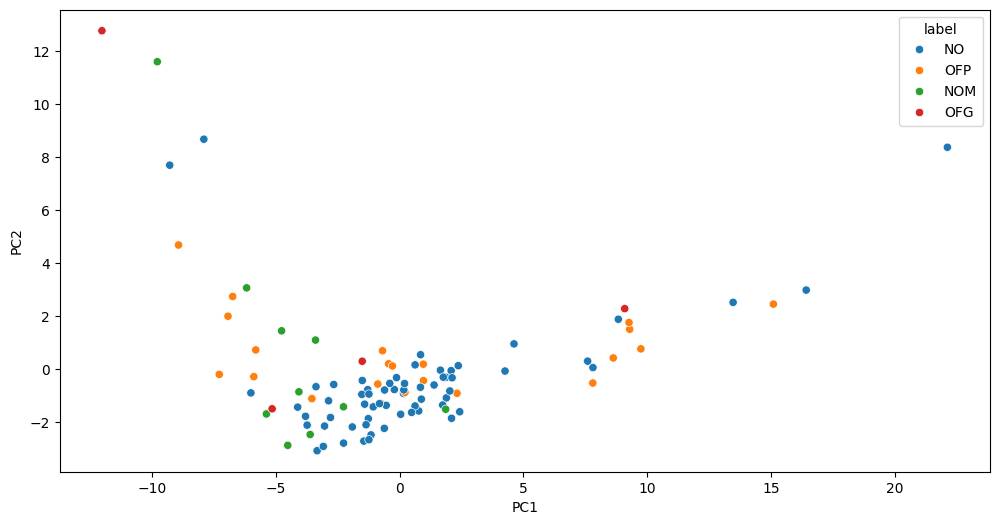

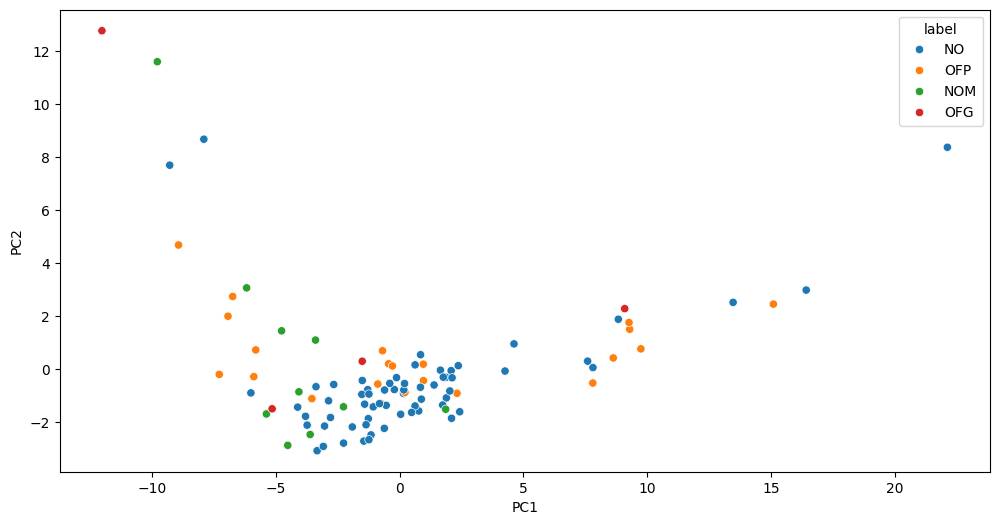

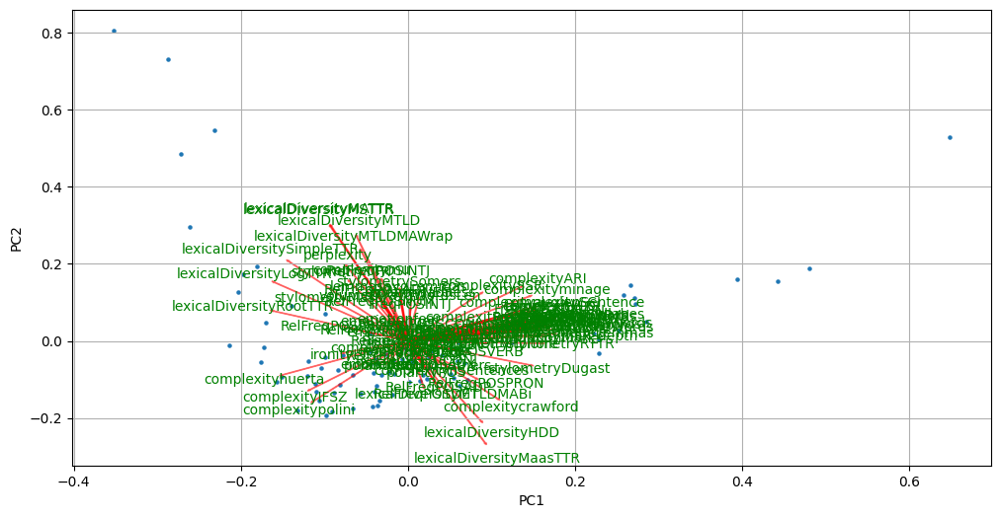

---------------------------- TSNE ----------------------------


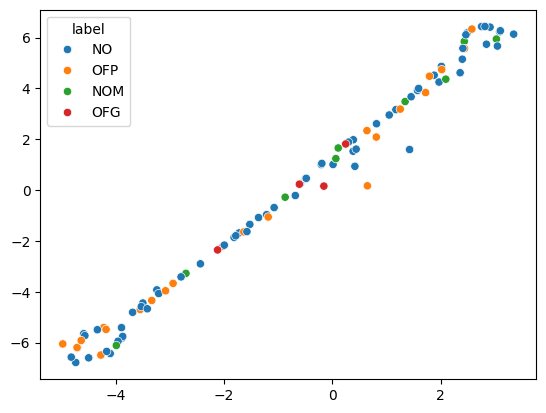

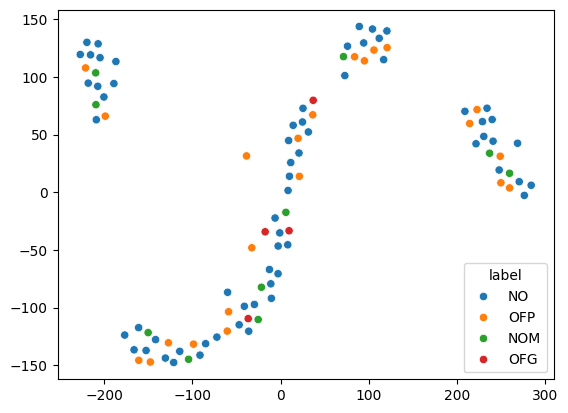

---------------------------- NNMF ----------------------------
error is 0.47
error is 0.41
error is 0.38
error is 0.37
error is 0.36
error is 0.36
error is 0.35
error is 0.35
error is 0.35
error is 0.34


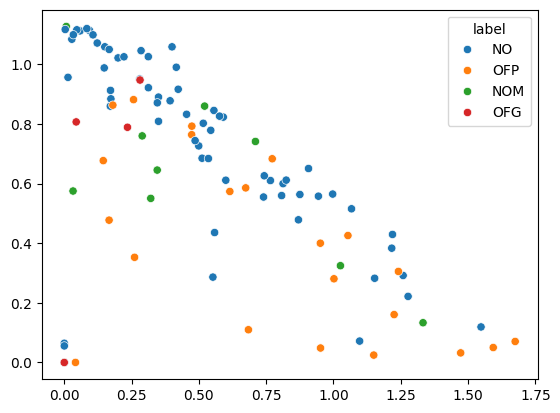

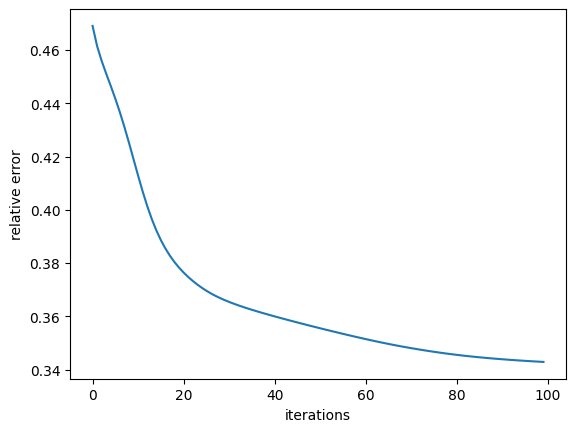

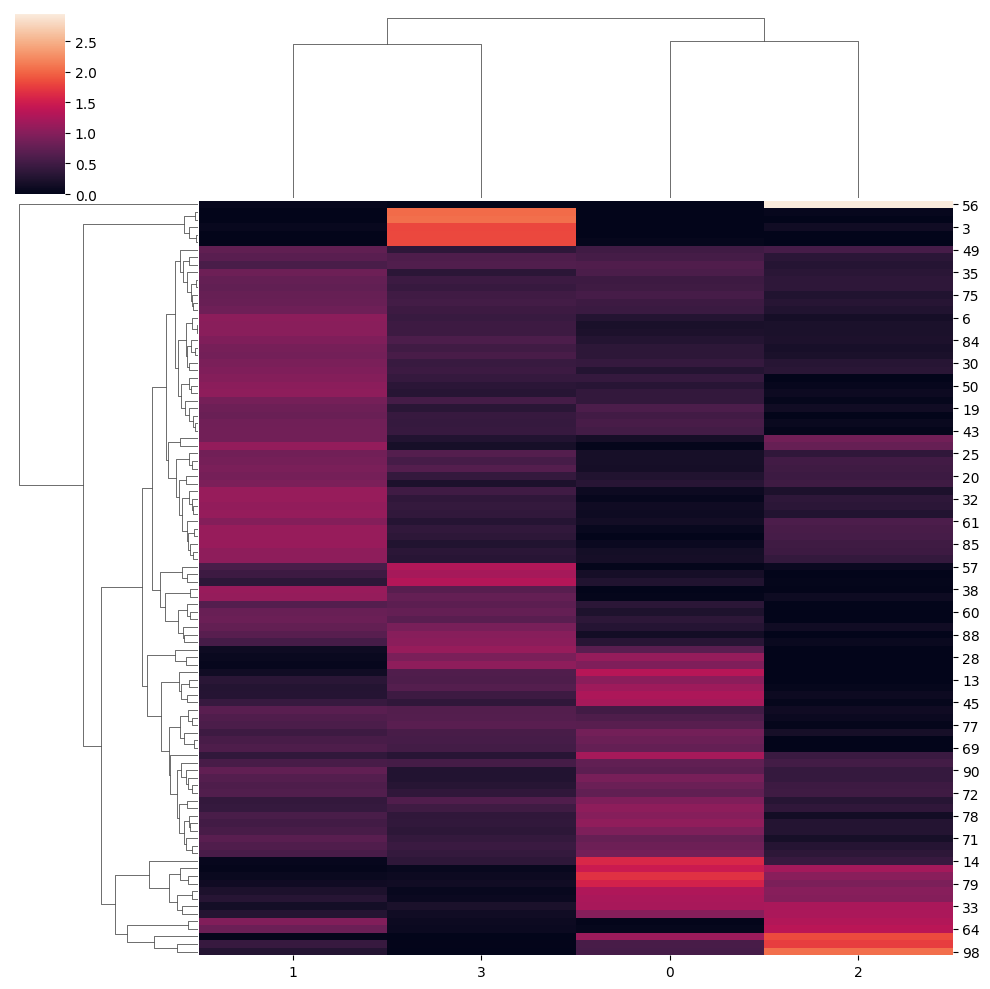

(array([[5.84514017e-02, 1.11197680e+00, 5.57290221e-01, 3.83208975e-01],
        [1.21632733e+00, 3.83290794e-01, 4.51244066e-01, 3.13043871e-01],
        [6.83994354e-01, 1.09796820e-01, 1.87942446e-05, 1.10670622e+00],
        [2.61867119e-05, 6.44629017e-02, 1.34137036e-01, 1.81235676e+00],
        [1.38450200e-02, 9.56170972e-01, 1.30033221e+00, 1.02175898e-01],
        [8.69767853e-01, 4.78432421e-01, 1.73706139e-01, 5.55208647e-01],
        [2.85242877e-01, 1.04566354e+00, 1.71087642e-01, 4.42458951e-01],
        [4.73859370e-01, 7.92514897e-01, 3.05997080e-01, 5.19001954e-01],
        [2.10210760e-09, 6.73891954e-08, 2.26868096e-04, 1.82582817e+00],
        [4.16547525e-02, 1.61255600e-04, 3.26003430e-03, 1.83035797e+00],
        [1.70990613e-01, 8.59688348e-01, 8.57317178e-01, 2.69054542e-01],
        [3.78034721e-05, 4.38190718e-06, 4.66092061e-02, 2.03190516e+00],
        [1.50544790e-01, 1.05863217e+00, 4.79530454e-01, 3.35022737e-01],
        [1.02578648e+00, 3.24567888e-0

In [ ]:
print('---------------------------- PCA ----------------------------')
v.show_pca(X, y, biplot= False, labelColumn= 'label') #Without biplot
v.show_pca(X, y, labelColumn= 'label') #With biplot
print('---------------------------- TSNE ----------------------------')
v.show_tsne(X, label=y) # Use tsne=TSNE(random_state = 0)
v.show_tsne(X, tsne = TSNE(perplexity = 9, early_exaggeration = 11, learning_rate = 451, random_state = 0), label=y)
print('---------------------------- NNMF ----------------------------')
v.show_nnmf(4, X, y, 100)